In [2]:
import os
import json
from collections import defaultdict
from packaging.version import parse as parse_version
import warnings
warnings.filterwarnings('ignore')

import cv2 
import imageio
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from skimage.transform import resize

import tensorflow as tf
from tensorflow.keras import layers, Model
from tensorflow.keras.activations import relu, tanh, elu
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from tensorflow.keras.losses import BinaryCrossentropy
from tensorflow.keras.optimizers import RMSprop, Adam
from tensorflow.keras.metrics import binary_accuracy
import tensorflow_datasets as tfds
from tensorflow_addons.layers import InstanceNormalization

from keras.utils import plot_model

print("Tensorflow", tf.__version__)
print("GPU is", "available" if tf.config.list_physical_devices('GPU') else "NOT AVAILABLE")


2024-08-06 16:03:15.659584: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-08-06 16:03:15.716096: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI AVX512_BF16 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-08-06 16:03:16.837827: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


Tensorflow 2.12.0
GPU is available


2024-08-06 16:03:18.924234: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:982] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-08-06 16:03:19.048338: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:982] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-08-06 16:03:19.048420: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:982] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.


In [3]:
custom_dir = '../tf_datasets'

In [4]:
# Load dataset specifications
specs = np.load(os.path.join(custom_dir, 'dataset_specs.npy'), allow_pickle=True).item()
t1_spec = specs['t1_spec']
t2_spec = specs['t2_spec']
t3_spec = specs['t3_spec']
t4_spec = specs['t4_spec']

In [5]:
# Load the datasets from the custom directory
t1_dataset = tf.data.experimental.load(os.path.join(custom_dir, 't1_dataset'), t1_spec)
t2_dataset = tf.data.experimental.load(os.path.join(custom_dir, 't2_dataset'), t2_spec)
t3_dataset = tf.data.experimental.load(os.path.join(custom_dir, 't3_dataset'), t3_spec)
t4_dataset = tf.data.experimental.load(os.path.join(custom_dir, 't4_dataset'), t4_spec)

Instructions for updating:
Use `tf.data.Dataset.load(...)` instead.


2024-08-06 16:04:41.478588: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:982] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-08-06 16:04:41.478769: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:982] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-08-06 16:04:41.478817: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:982] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-08-06 16:04:41.664285: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:982] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-08-06 16:04:41.664394: I tensorflow/compile

In [6]:
# Function to plot images from a dataset
def plot_images(dataset, num_images):
    plt.figure(figsize=(10, 10))
    for i, image in enumerate(dataset.take(num_images)):
        plt.subplot(1, num_images, i+1)
        plt.imshow(image.numpy())
        plt.axis('off')
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7411765].


Plotting images from loaded dataset:


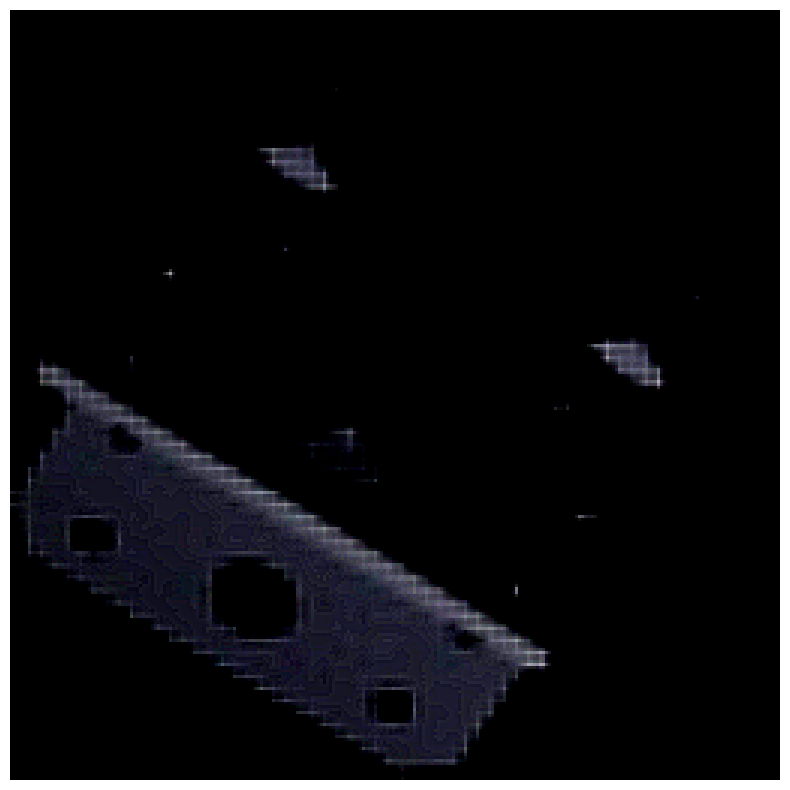

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.96862745..1.0].


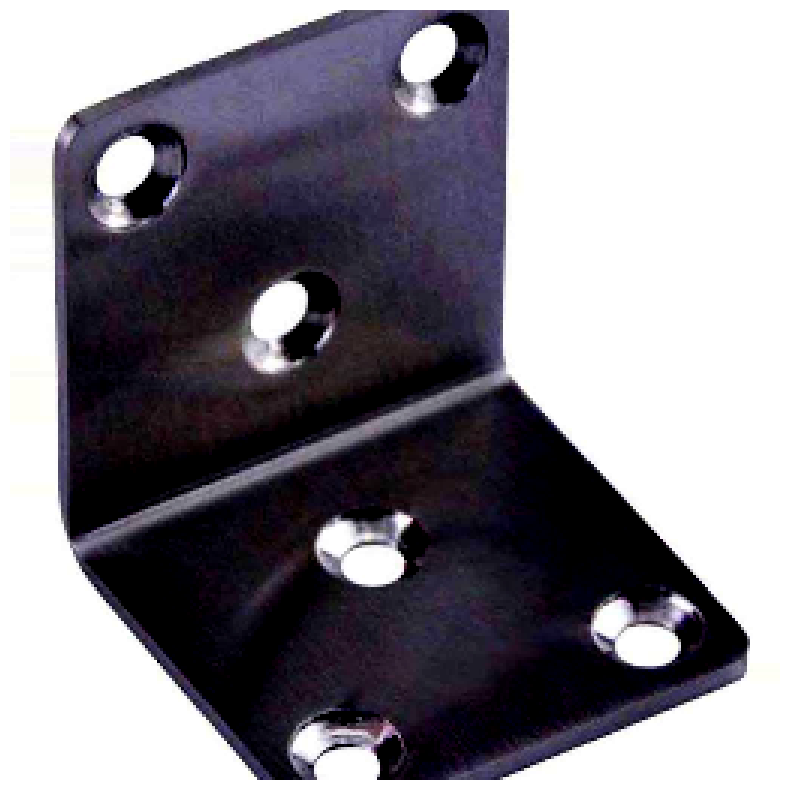

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7647059].


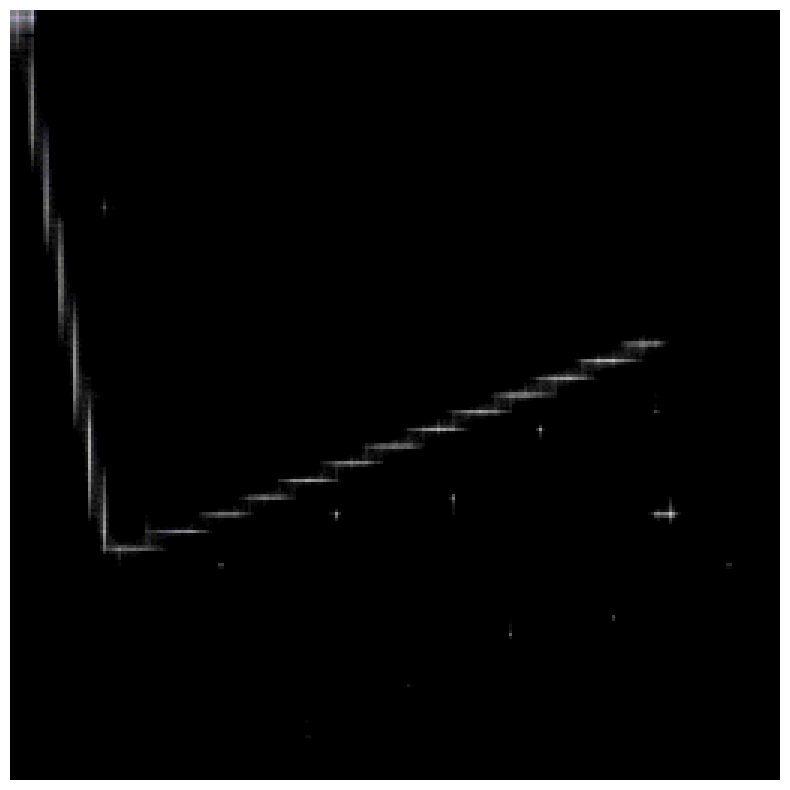

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99215686..1.0].


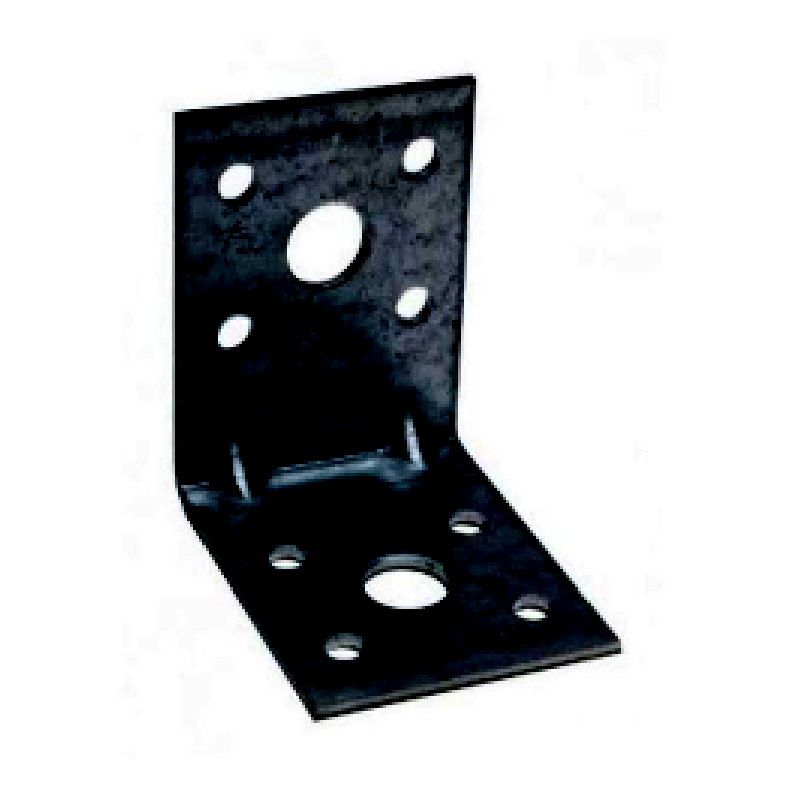

In [12]:
print("Plotting images from loaded dataset:")
plot_images(t1_dataset.unbatch().take(1), 1)
plot_images(t2_dataset.unbatch().take(1), 1)
plot_images(t3_dataset.unbatch().take(1), 1)
plot_images(t4_dataset.unbatch().take(1), 1)

In [13]:
from tensorflow import keras
# Weights initializer for the layers.
kernel_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
# Gamma initializer for instance normalization.
gamma_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

buffer_size = 128
batch_size = 1

In [14]:
import tensorflow_addons as tfa
class ReflectionPadding2D(layers.Layer):
    """Implements Reflection Padding as a layer.

    Args:
        padding(tuple): Amount of padding for the
        spatial dimensions.

    Returns:
        A padded tensor with the same type as the input tensor.
    """

    def __init__(self, padding=(1, 1), **kwargs):
        self.padding = tuple(padding)
        super().__init__(**kwargs)

    def call(self, input_tensor, mask=None):
        padding_width, padding_height = self.padding
        padding_tensor = [
            [0, 0],
            [padding_height, padding_height],
            [padding_width, padding_width],
            [0, 0],
        ]
        return tf.pad(input_tensor, padding_tensor, mode="REFLECT")


def residual_block(
    x,
    activation,
    kernel_initializer=kernel_init,
    kernel_size=(3, 3),
    strides=(1, 1),
    padding="valid",
    gamma_initializer=gamma_init,
    use_bias=False,
):
    dim = x.shape[-1]
    input_tensor = x

    x = ReflectionPadding2D()(input_tensor)
    x = layers.Conv2D(
        dim,
        kernel_size,
        strides=strides,
        kernel_initializer=kernel_initializer,
        padding=padding,
        use_bias=use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    x = activation(x)

    x = ReflectionPadding2D()(x)
    x = layers.Conv2D(
        dim,
        kernel_size,
        strides=strides,
        kernel_initializer=kernel_initializer,
        padding=padding,
        use_bias=use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    x = layers.add([input_tensor, x])
    return x


def downsample(
    x,
    filters,
    activation,
    kernel_initializer=kernel_init,
    kernel_size=(3, 3),
    strides=(2, 2),
    padding="same",
    gamma_initializer=gamma_init,
    use_bias=False,
):
    x = layers.Conv2D(
        filters,
        kernel_size,
        strides=strides,
        kernel_initializer=kernel_initializer,
        padding=padding,
        use_bias=use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    if activation:
        x = activation(x)
    return x


def upsample(
    x,
    filters,
    activation,
    kernel_size=(3, 3),
    strides=(2, 2),
    padding="same",
    kernel_initializer=kernel_init,
    gamma_initializer=gamma_init,
    use_bias=False,
):
    x = layers.Conv2DTranspose(
        filters,
        kernel_size,
        strides=strides,
        padding=padding,
        kernel_initializer=kernel_initializer,
        use_bias=use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    if activation:
        x = activation(x)
    return x


In [15]:
input_img_size = (256, 256, 3)
def get_resnet_generator(
    filters=32,
    num_downsampling_blocks=2,
    num_residual_blocks=6,
    num_upsample_blocks=2,
    gamma_initializer=gamma_init,
    name=None,
):
    img_input = layers.Input(shape=input_img_size, name=name + "_img_input")
    x = ReflectionPadding2D(padding=(3, 3))(img_input)
    x = layers.Conv2D(filters, (7, 7), kernel_initializer=kernel_init, use_bias=False)(
        x
    )
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    x = layers.Activation("elu")(x)

    # Downsampling
    for _ in range(num_downsampling_blocks):
        filters *= 2
        x = downsample(x, filters=filters, activation=layers.Activation("elu"))

    # Residual blocks
    for _ in range(num_residual_blocks):
        x = residual_block(x, activation=layers.Activation("elu"))

    # Upsampling
    for _ in range(num_upsample_blocks):
        filters //= 2
        x = upsample(x, filters, activation=layers.Activation("elu"))

    # Final block
    x = ReflectionPadding2D(padding=(3, 3))(x)
    x = layers.Conv2D(3, (7, 7), padding="valid")(x)
    x = layers.Activation("tanh")(x)

    model = keras.models.Model(img_input, x, name=name)
    return model

In [16]:
input_img_size = (256, 256, 3)
def get_discriminator(
    filters=32, kernel_initializer=kernel_init, num_downsampling=3, name=None
):
    img_input = layers.Input(shape=input_img_size, name=name + "_img_input")
    x = layers.Conv2D(
        filters,
        (4, 4),
        strides=(2, 2),
        padding="same",
        kernel_initializer=kernel_initializer,
    )(img_input)
    x = layers.LeakyReLU(0.2)(x)

    num_filters = filters
    for num_downsample_block in range(3):
        num_filters *= 2
        if num_downsample_block < 2:
            x = downsample(
                x,
                filters=num_filters,
                activation=layers.LeakyReLU(0.2),
                kernel_size=(4, 4),
                strides=(2, 2),
            )
        else:
            x = downsample(
                x,
                filters=num_filters,
                activation=layers.LeakyReLU(0.2),
                kernel_size=(4, 4),
                strides=(1, 1),
            )

    x = layers.Conv2D(
        1, (4, 4), strides=(1, 1), padding="same", kernel_initializer=kernel_initializer
    )(x)

    model = keras.models.Model(inputs=img_input, outputs=x, name=name)
    return model


# Get the generators
gen_G = get_resnet_generator(name="generator_G")
gen_F = get_resnet_generator(name="generator_F")

# Get the discriminators
disc_X = get_discriminator(name="discriminator_X")
disc_Y = get_discriminator(name="discriminator_Y")

In [17]:
class CycleGan(keras.Model):
    def __init__(
        self,
        generator_G,
        generator_F,
        discriminator_X,
        discriminator_Y,
        lambda_cycle=10.0,
        lambda_identity=0.5,
    ):
        super().__init__()
        self.gen_G = generator_G
        self.gen_F = generator_F
        self.disc_X = discriminator_X
        self.disc_Y = discriminator_Y
        self.lambda_cycle = lambda_cycle
        self.lambda_identity = lambda_identity

    def compile(
        self,
        gen_G_optimizer,
        gen_F_optimizer,
        disc_X_optimizer,
        disc_Y_optimizer,
        gen_loss_fn,
        disc_loss_fn,
    ):
        super().compile()
        self.gen_G_optimizer = gen_G_optimizer
        self.gen_F_optimizer = gen_F_optimizer
        self.disc_X_optimizer = disc_X_optimizer
        self.disc_Y_optimizer = disc_Y_optimizer
        self.generator_loss_fn = gen_loss_fn
        self.discriminator_loss_fn = disc_loss_fn
        self.cycle_loss_fn = keras.losses.MeanAbsoluteError()
        self.identity_loss_fn = keras.losses.MeanAbsoluteError()

    def train_step(self, batch_data):
        # x is Horse and y is zebra
        real_x, real_y = batch_data

        # For CycleGAN, we need to calculate different
        # kinds of losses for the generators and discriminators.
        # We will perform the following steps here:
        #
        # 1. Pass real images through the generators and get the generated images
        # 2. Pass the generated images back to the generators to check if we
        #    can predict the original image from the generated image.
        # 3. Do an identity mapping of the real images using the generators.
        # 4. Pass the generated images in 1) to the corresponding discriminators.
        # 5. Calculate the generators total loss (adversarial + cycle + identity)
        # 6. Calculate the discriminators loss
        # 7. Update the weights of the generators
        # 8. Update the weights of the discriminators
        # 9. Return the losses in a dictionary

        with tf.GradientTape(persistent=True) as tape:
            # Horse to fake zebra
            fake_y = self.gen_G(real_x, training=True)
            # Zebra to fake horse -> y2x
            fake_x = self.gen_F(real_y, training=True)

            # Cycle (Horse to fake zebra to fake horse): x -> y -> x
            cycled_x = self.gen_F(fake_y, training=True)
            # Cycle (Zebra to fake horse to fake zebra) y -> x -> y
            cycled_y = self.gen_G(fake_x, training=True)

            # Identity mapping
            same_x = self.gen_F(real_x, training=True)
            same_y = self.gen_G(real_y, training=True)

            # Discriminator output
            disc_real_x = self.disc_X(real_x, training=True)
            disc_fake_x = self.disc_X(fake_x, training=True)

            disc_real_y = self.disc_Y(real_y, training=True)
            disc_fake_y = self.disc_Y(fake_y, training=True)

            # Generator adversarial loss
            gen_G_loss = self.generator_loss_fn(disc_fake_y)
            gen_F_loss = self.generator_loss_fn(disc_fake_x)

            # Generator cycle loss
            cycle_loss_G = self.cycle_loss_fn(real_y, cycled_y) * self.lambda_cycle
            cycle_loss_F = self.cycle_loss_fn(real_x, cycled_x) * self.lambda_cycle

            # Generator identity loss
            id_loss_G = (
                self.identity_loss_fn(real_y, same_y)
                * self.lambda_cycle
                * self.lambda_identity
            )
            id_loss_F = (
                self.identity_loss_fn(real_x, same_x)
                * self.lambda_cycle
                * self.lambda_identity
            )

            # Total generator loss
            total_loss_G = gen_G_loss + cycle_loss_G + id_loss_G
            total_loss_F = gen_F_loss + cycle_loss_F + id_loss_F

            # Discriminator loss
            disc_X_loss = self.discriminator_loss_fn(disc_real_x, disc_fake_x)
            disc_Y_loss = self.discriminator_loss_fn(disc_real_y, disc_fake_y)

        # Get the gradients for the generators
        grads_G = tape.gradient(total_loss_G, self.gen_G.trainable_variables)
        grads_F = tape.gradient(total_loss_F, self.gen_F.trainable_variables)

        # Get the gradients for the discriminators
        disc_X_grads = tape.gradient(disc_X_loss, self.disc_X.trainable_variables)
        disc_Y_grads = tape.gradient(disc_Y_loss, self.disc_Y.trainable_variables)

        # Update the weights of the generators
        self.gen_G_optimizer.apply_gradients(
            zip(grads_G, self.gen_G.trainable_variables)
        )
        self.gen_F_optimizer.apply_gradients(
            zip(grads_F, self.gen_F.trainable_variables)
        )

        # Update the weights of the discriminators
        self.disc_X_optimizer.apply_gradients(
            zip(disc_X_grads, self.disc_X.trainable_variables)
        )
        self.disc_Y_optimizer.apply_gradients(
            zip(disc_Y_grads, self.disc_Y.trainable_variables)
        )

        return {
            "G_loss": total_loss_G,
            "F_loss": total_loss_F,
            "D_X_loss": disc_X_loss,
            "D_Y_loss": disc_Y_loss,
        }

In [20]:
class GANMonitor(keras.callbacks.Callback):
    """A callback to generate and save images after each epoch"""

    def __init__(self, num_img=4):
        self.num_img = num_img

    def on_epoch_end(self, epoch, logs=None):
        _, ax = plt.subplots(4, 2, figsize=(12, 12))
        for i, img in enumerate(t3_dataset.take(self.num_img)):
            prediction = self.model.gen_G(img)[0].numpy()
            prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
            img = (img[0] * 127.5 + 127.5).numpy().astype(np.uint8)

            ax[i, 0].imshow(img)
            ax[i, 1].imshow(prediction)
            ax[i, 0].set_title("Input image")
            ax[i, 1].set_title("Translated image")
            ax[i, 0].axis("off")
            ax[i, 1].axis("off")

            prediction = keras.utils.array_to_img(prediction)
            #prediction.save("generated_img_{i}_{epoch}.png".format(i=i, epoch=epoch + 1))
        #plt.savefig(f"/content/drive/MyDrive/Output/Images/image_at_epoch_{epoch+1}.png")
        plt.show()
        plt.close()

Epoch 1/35
590/590 [==============================] - ETA: 0s - G_loss: 3.9971 - F_loss: 3.0269 - D_X_loss: 0.1572 - D_Y_loss: 0.0245

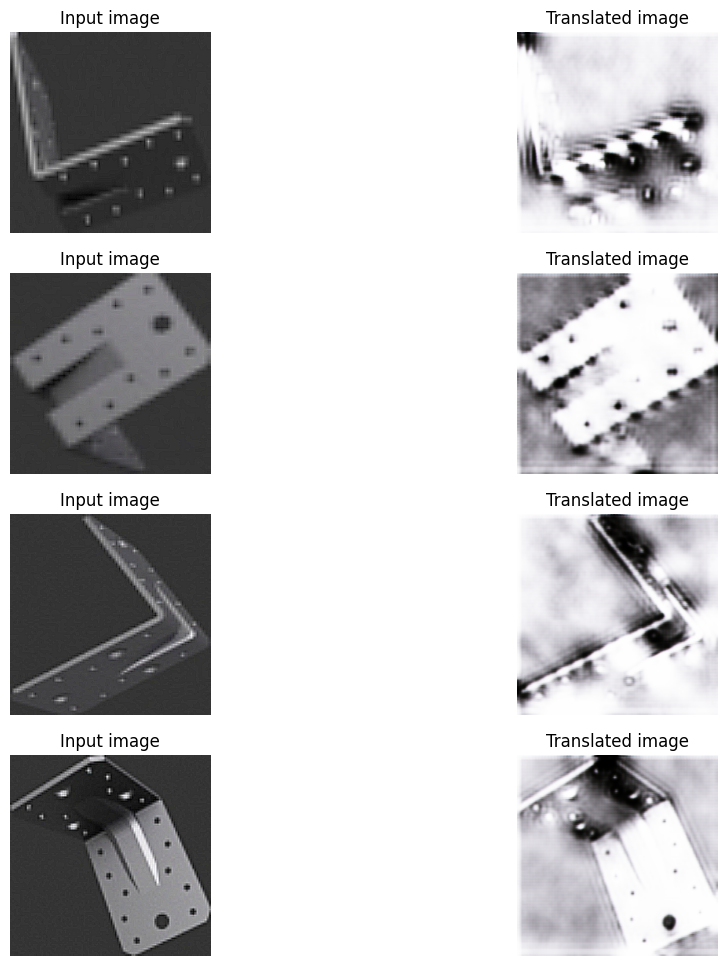

590/590 [==============================] - 242s 362ms/step - G_loss: 3.9965 - F_loss: 3.0287 - D_X_loss: 0.1572 - D_Y_loss: 0.0245
Epoch 2/35
590/590 [==============================] - ETA: 0s - G_loss: 4.5678 - F_loss: 3.1300 - D_X_loss: 0.1517 - D_Y_loss: 0.0289

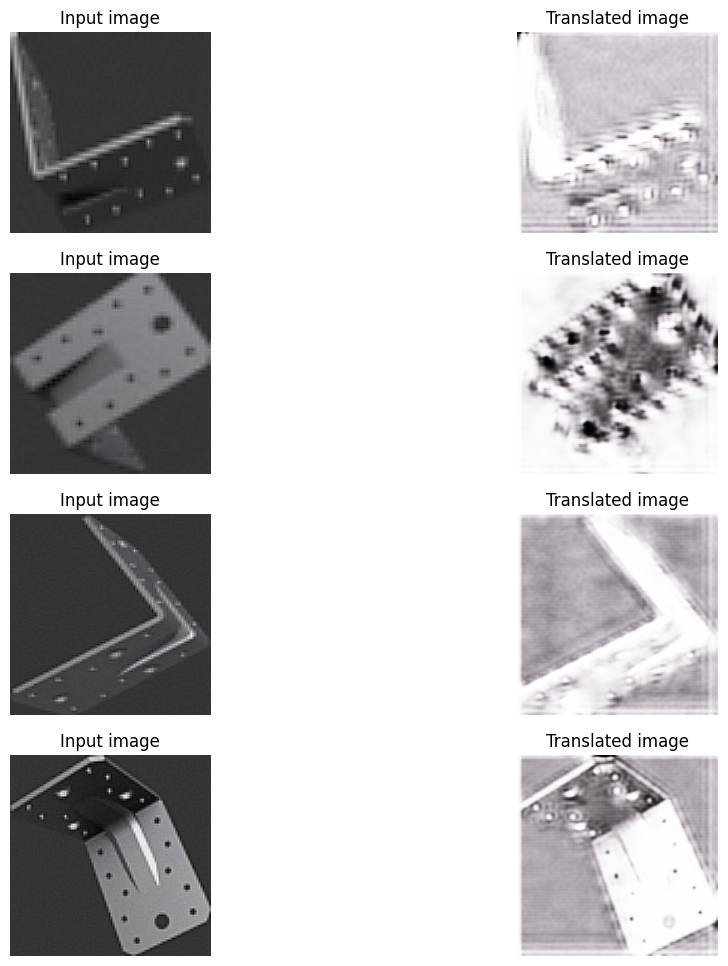

590/590 [==============================] - 207s 351ms/step - G_loss: 4.5636 - F_loss: 3.1326 - D_X_loss: 0.1516 - D_Y_loss: 0.0290
Epoch 3/35
590/590 [==============================] - ETA: 0s - G_loss: 4.0106 - F_loss: 3.1886 - D_X_loss: 0.1407 - D_Y_loss: 0.0357

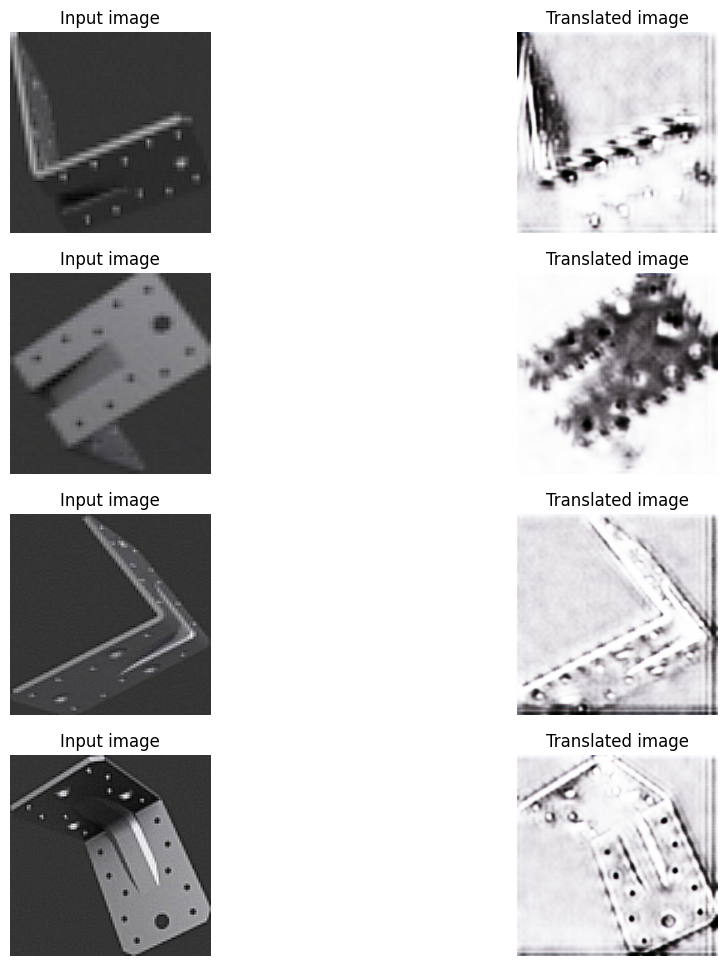

590/590 [==============================] - 226s 384ms/step - G_loss: 4.0071 - F_loss: 3.1910 - D_X_loss: 0.1406 - D_Y_loss: 0.0358
Epoch 4/35
590/590 [==============================] - ETA: 0s - G_loss: 3.7931 - F_loss: 3.1057 - D_X_loss: 0.1406 - D_Y_loss: 0.0287

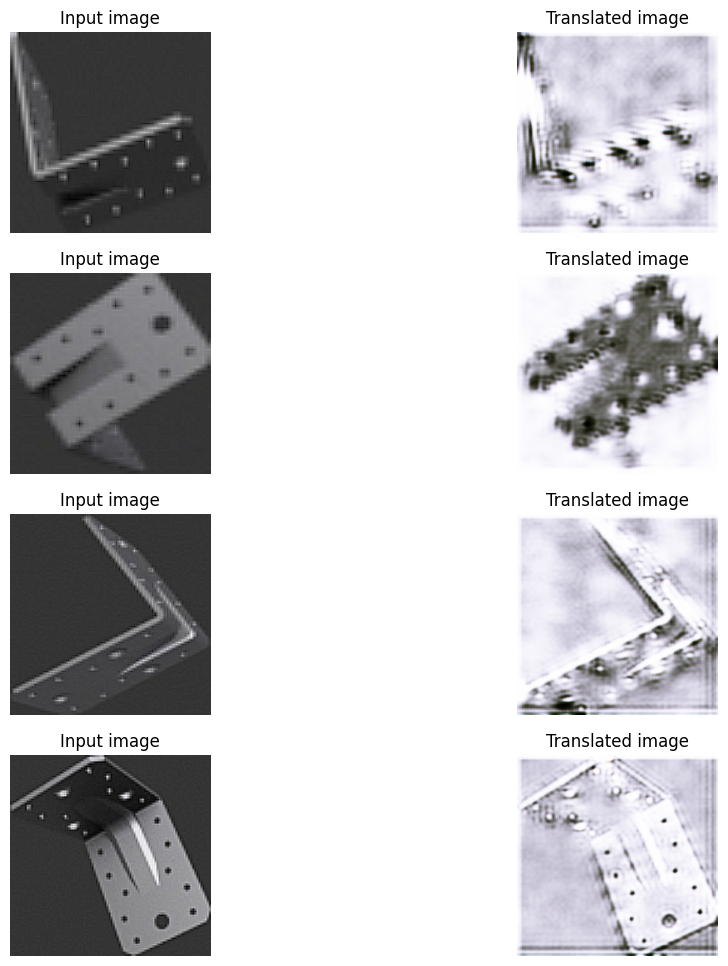

590/590 [==============================] - 222s 376ms/step - G_loss: 3.7910 - F_loss: 3.1100 - D_X_loss: 0.1405 - D_Y_loss: 0.0287
Epoch 5/35
590/590 [==============================] - ETA: 0s - G_loss: 3.8984 - F_loss: 3.1604 - D_X_loss: 0.1213 - D_Y_loss: 0.0107

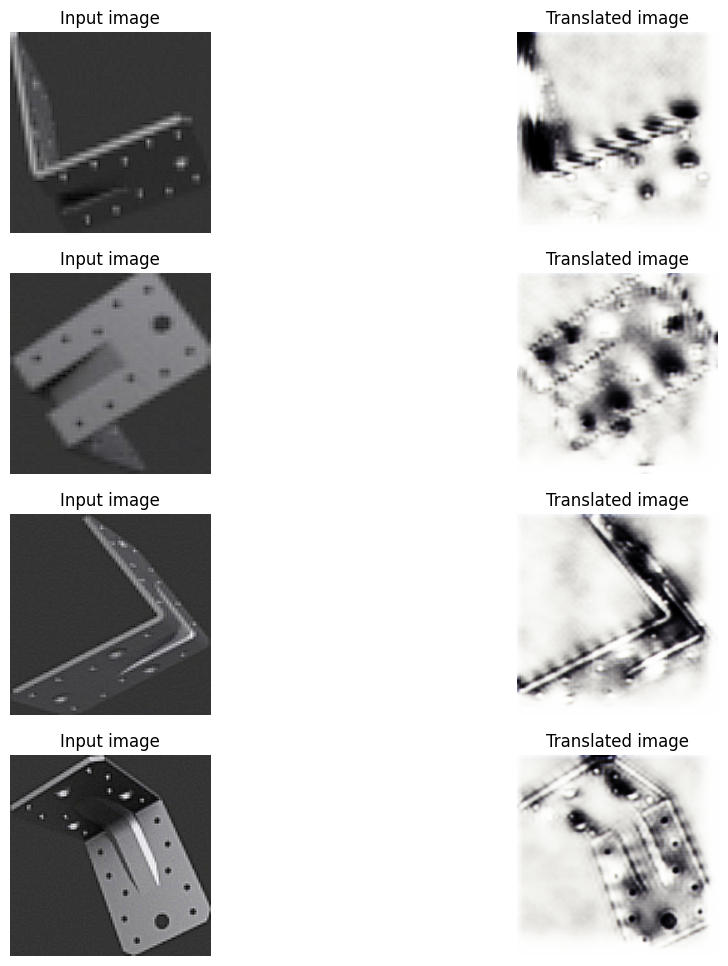

590/590 [==============================] - 206s 349ms/step - G_loss: 3.8990 - F_loss: 3.1645 - D_X_loss: 0.1213 - D_Y_loss: 0.0106
Epoch 6/35
590/590 [==============================] - ETA: 0s - G_loss: 4.0948 - F_loss: 3.1619 - D_X_loss: 0.1323 - D_Y_loss: 0.0115

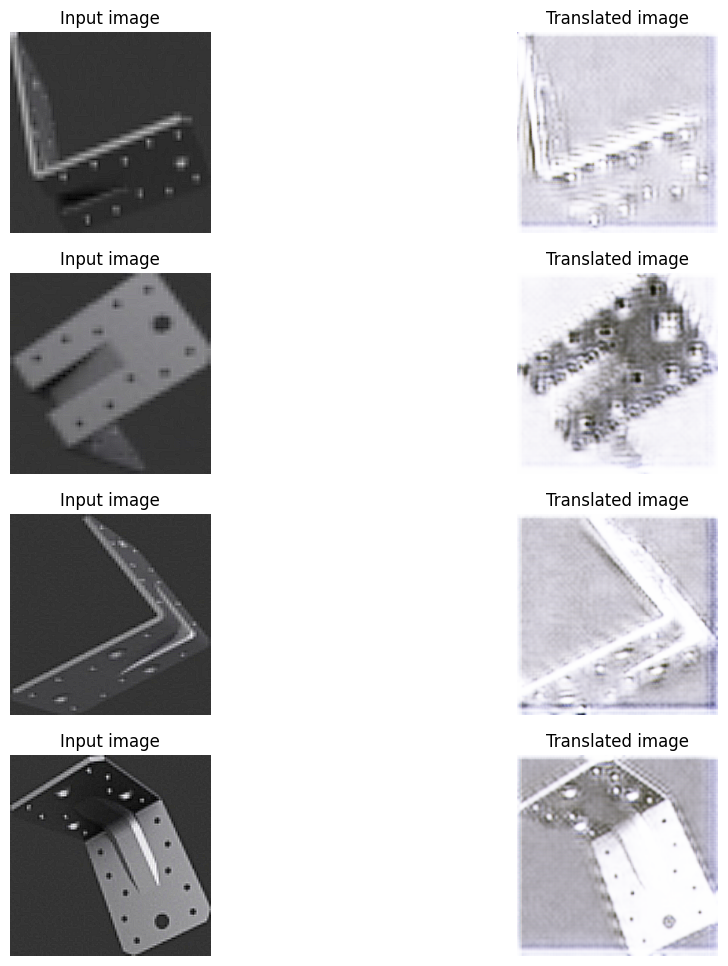

590/590 [==============================] - 135s 229ms/step - G_loss: 4.0917 - F_loss: 3.1668 - D_X_loss: 0.1322 - D_Y_loss: 0.0115
Epoch 7/35
590/590 [==============================] - ETA: 0s - G_loss: 3.6905 - F_loss: 3.0555 - D_X_loss: 0.1338 - D_Y_loss: 0.0191

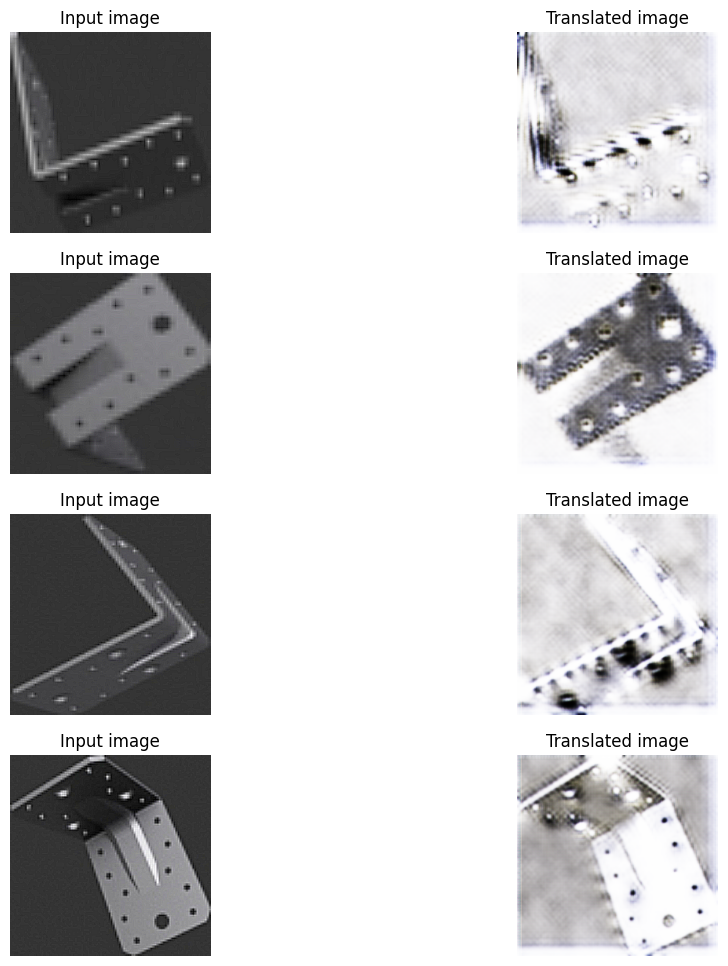

590/590 [==============================] - 134s 228ms/step - G_loss: 3.6874 - F_loss: 3.0590 - D_X_loss: 0.1336 - D_Y_loss: 0.0192
Epoch 8/35
590/590 [==============================] - ETA: 0s - G_loss: 3.9344 - F_loss: 3.1136 - D_X_loss: 0.1267 - D_Y_loss: 0.0114

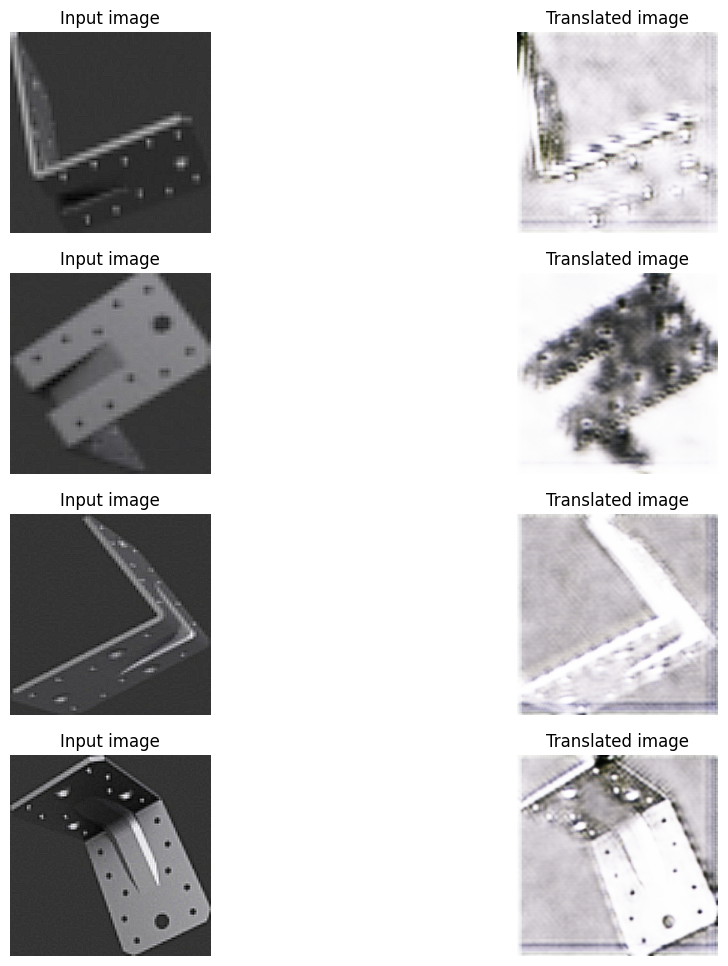

590/590 [==============================] - 133s 225ms/step - G_loss: 3.9316 - F_loss: 3.1161 - D_X_loss: 0.1265 - D_Y_loss: 0.0114
Epoch 9/35
590/590 [==============================] - ETA: 0s - G_loss: 3.8092 - F_loss: 3.1301 - D_X_loss: 0.1200 - D_Y_loss: 0.0066

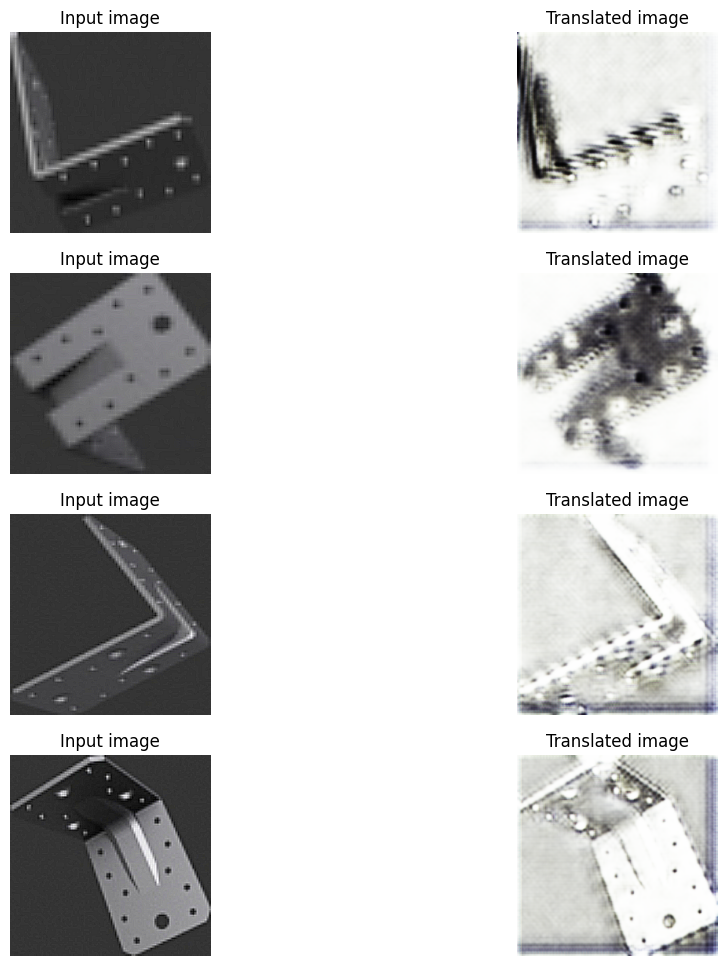

590/590 [==============================] - 131s 222ms/step - G_loss: 3.8077 - F_loss: 3.1327 - D_X_loss: 0.1200 - D_Y_loss: 0.0066
Epoch 10/35
590/590 [==============================] - ETA: 0s - G_loss: 3.8006 - F_loss: 3.1004 - D_X_loss: 0.1191 - D_Y_loss: 0.0125

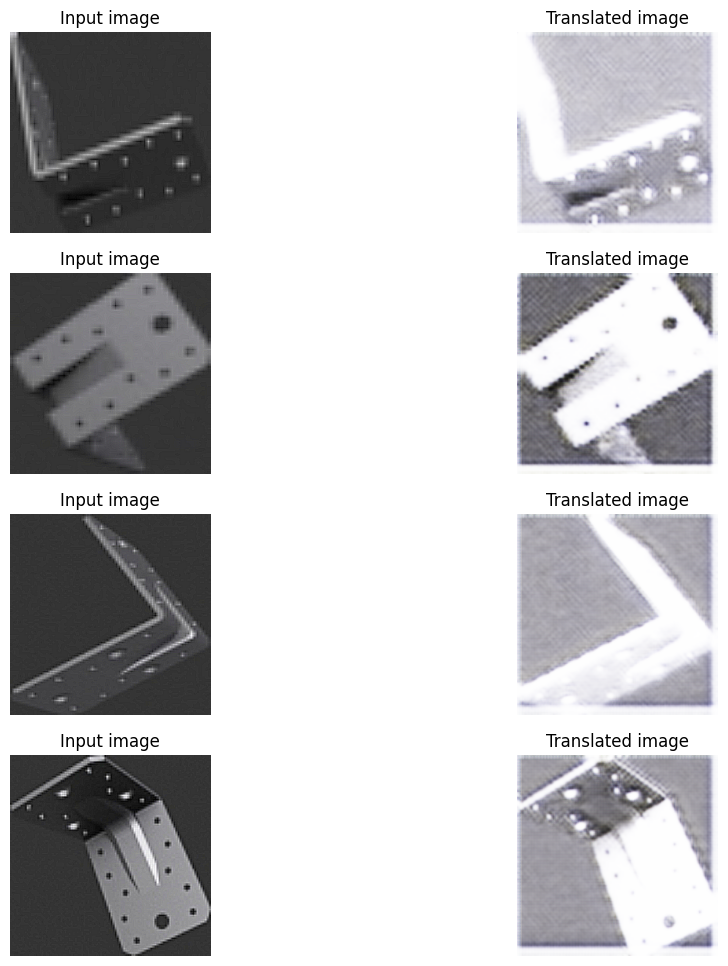

590/590 [==============================] - 130s 221ms/step - G_loss: 3.7976 - F_loss: 3.1028 - D_X_loss: 0.1189 - D_Y_loss: 0.0125
Epoch 11/35
590/590 [==============================] - ETA: 0s - G_loss: 3.7238 - F_loss: 3.0934 - D_X_loss: 0.1211 - D_Y_loss: 0.0125

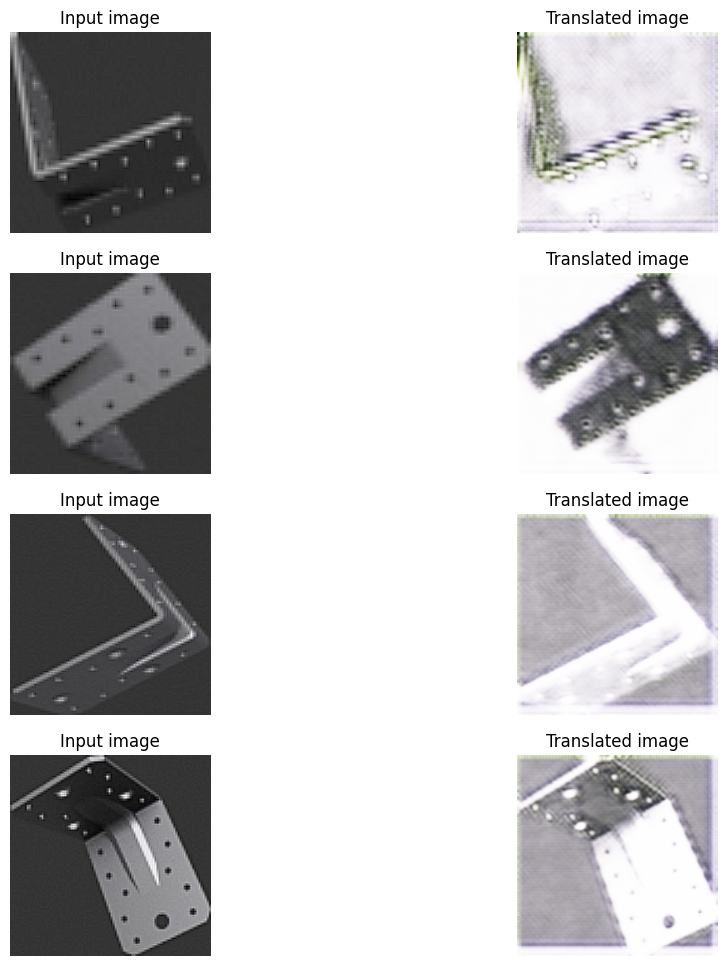

590/590 [==============================] - 129s 219ms/step - G_loss: 3.7221 - F_loss: 3.0938 - D_X_loss: 0.1211 - D_Y_loss: 0.0125
Epoch 12/35
590/590 [==============================] - ETA: 0s - G_loss: 3.3743 - F_loss: 3.0135 - D_X_loss: 0.1264 - D_Y_loss: 0.0386

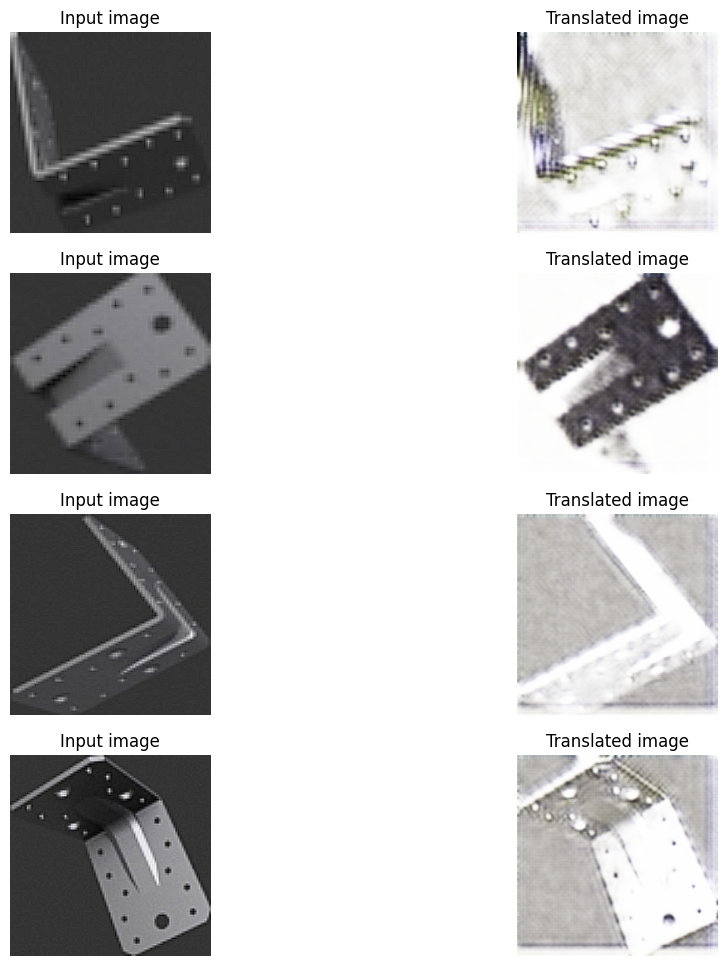

590/590 [==============================] - 130s 221ms/step - G_loss: 3.3711 - F_loss: 3.0164 - D_X_loss: 0.1263 - D_Y_loss: 0.0388
Epoch 13/35
590/590 [==============================] - ETA: 0s - G_loss: 3.0433 - F_loss: 2.9508 - D_X_loss: 0.1163 - D_Y_loss: 0.0497

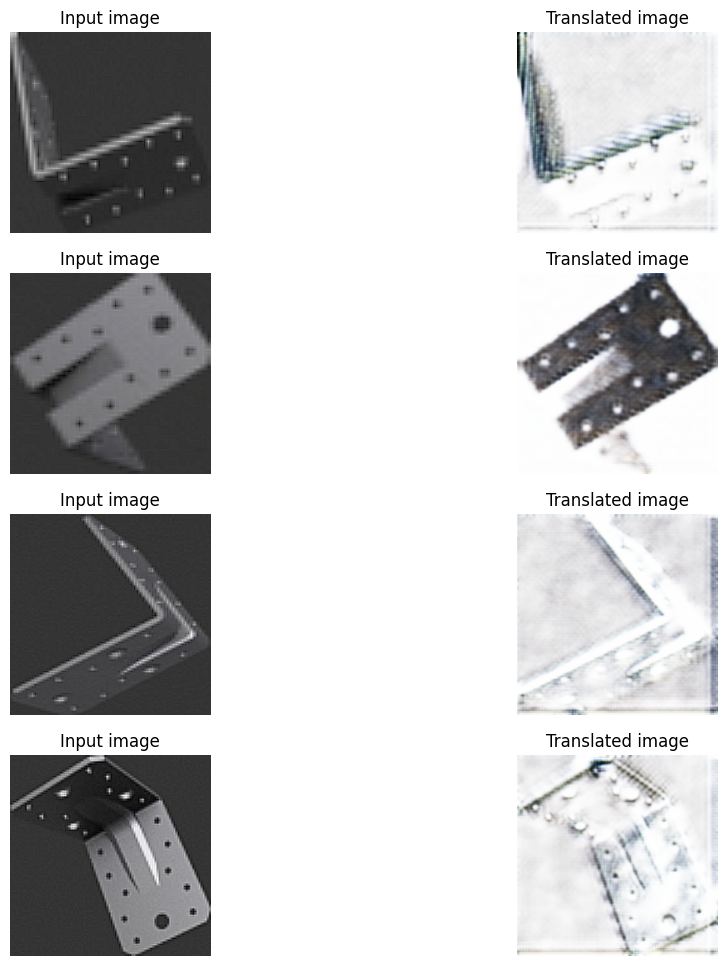

590/590 [==============================] - 130s 221ms/step - G_loss: 3.0403 - F_loss: 2.9527 - D_X_loss: 0.1162 - D_Y_loss: 0.0502
Epoch 14/35
590/590 [==============================] - ETA: 0s - G_loss: 3.1666 - F_loss: 3.0224 - D_X_loss: 0.1025 - D_Y_loss: 0.0255

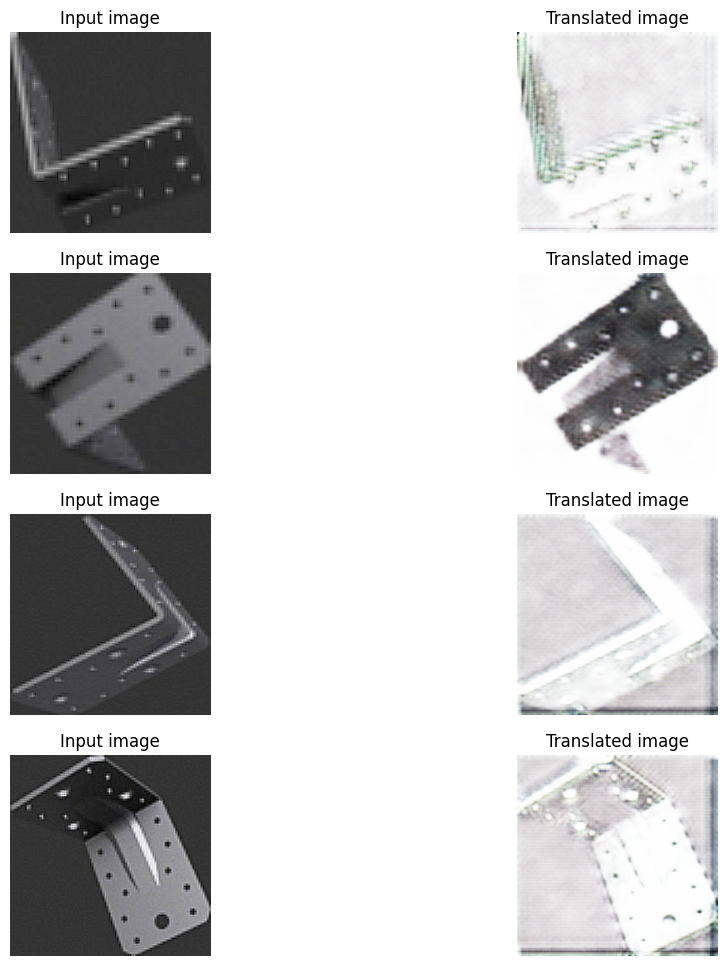

590/590 [==============================] - 131s 222ms/step - G_loss: 3.1641 - F_loss: 3.0243 - D_X_loss: 0.1026 - D_Y_loss: 0.0255
Epoch 15/35
590/590 [==============================] - ETA: 0s - G_loss: 2.9588 - F_loss: 2.9158 - D_X_loss: 0.1025 - D_Y_loss: 0.0346

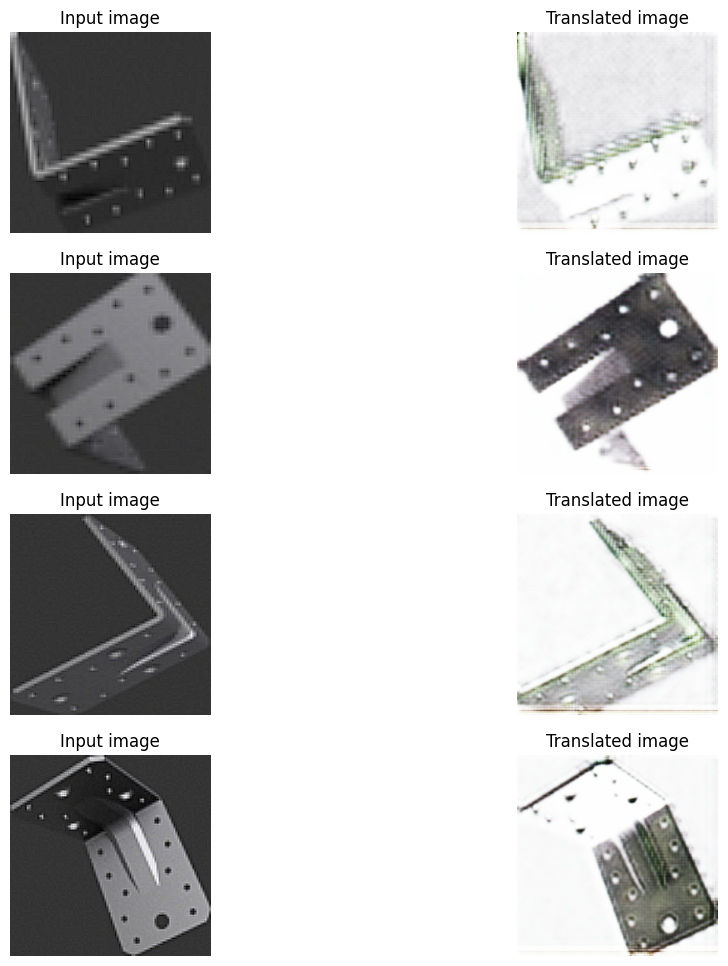

590/590 [==============================] - 132s 223ms/step - G_loss: 2.9561 - F_loss: 2.9175 - D_X_loss: 0.1026 - D_Y_loss: 0.0347
Epoch 16/35
590/590 [==============================] - ETA: 0s - G_loss: 2.6039 - F_loss: 2.9946 - D_X_loss: 0.0964 - D_Y_loss: 0.1104

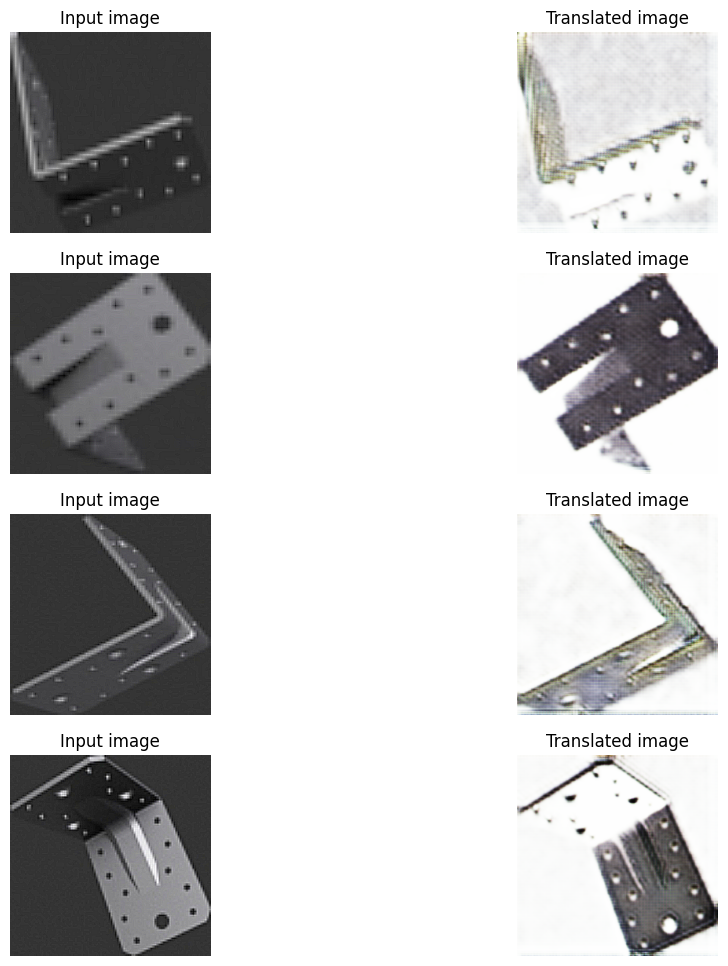

590/590 [==============================] - 130s 220ms/step - G_loss: 2.6028 - F_loss: 2.9963 - D_X_loss: 0.0964 - D_Y_loss: 0.1102
Epoch 17/35
590/590 [==============================] - ETA: 0s - G_loss: 3.0212 - F_loss: 2.9549 - D_X_loss: 0.0863 - D_Y_loss: 0.0432

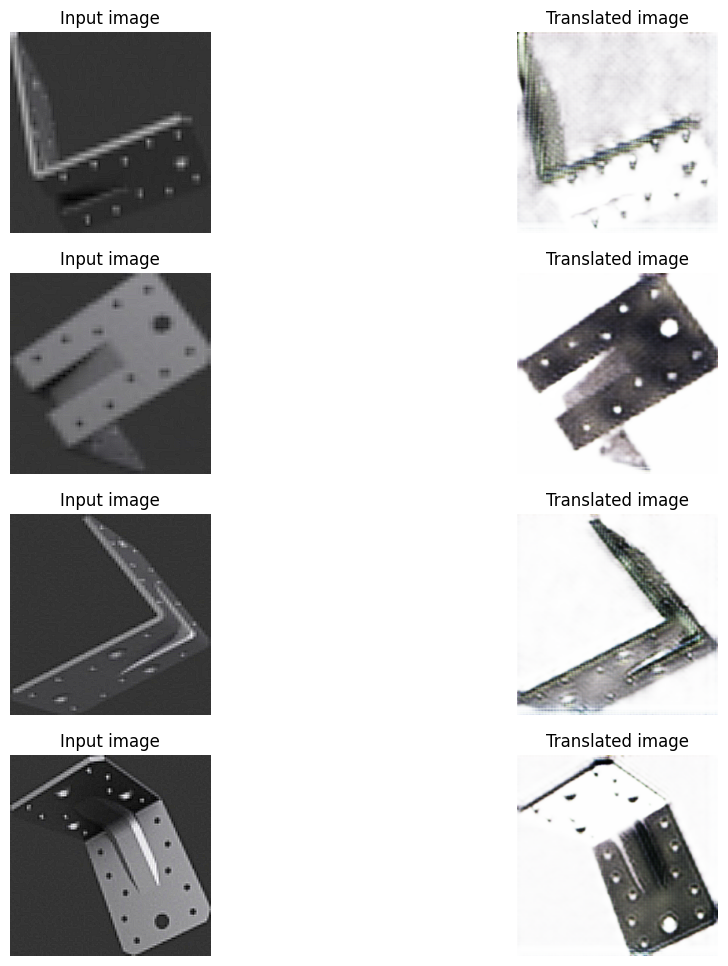

590/590 [==============================] - 130s 220ms/step - G_loss: 3.0182 - F_loss: 2.9561 - D_X_loss: 0.0862 - D_Y_loss: 0.0433
Epoch 18/35
590/590 [==============================] - ETA: 0s - G_loss: 2.6898 - F_loss: 2.9137 - D_X_loss: 0.0776 - D_Y_loss: 0.0464

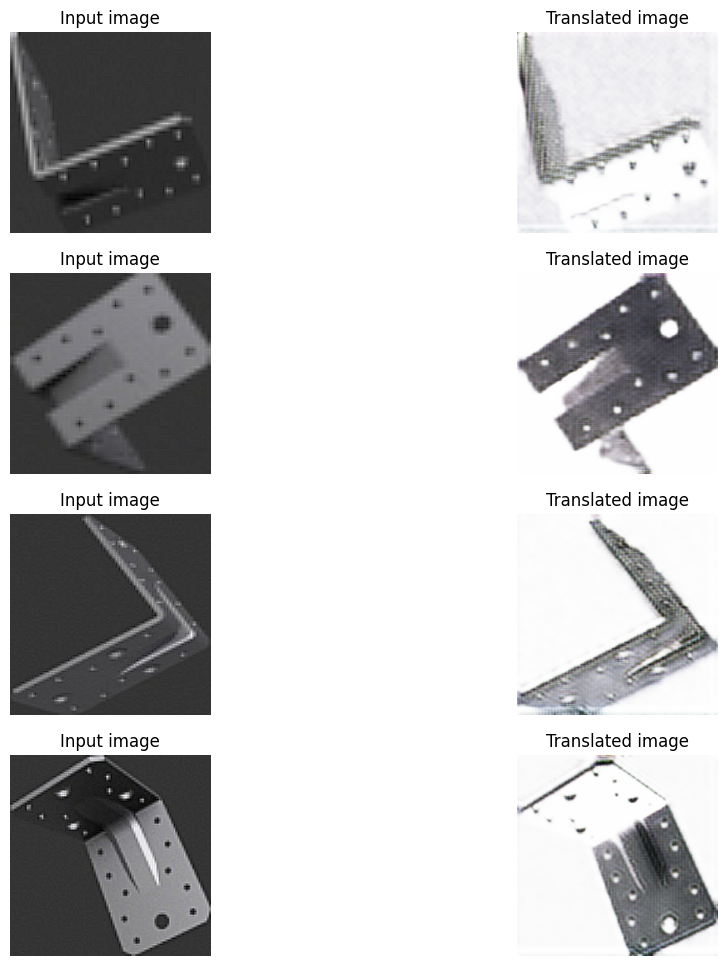

590/590 [==============================] - 131s 223ms/step - G_loss: 2.6885 - F_loss: 2.9152 - D_X_loss: 0.0775 - D_Y_loss: 0.0464
Epoch 19/35
590/590 [==============================] - ETA: 0s - G_loss: 2.9375 - F_loss: 2.9928 - D_X_loss: 0.0758 - D_Y_loss: 0.0400

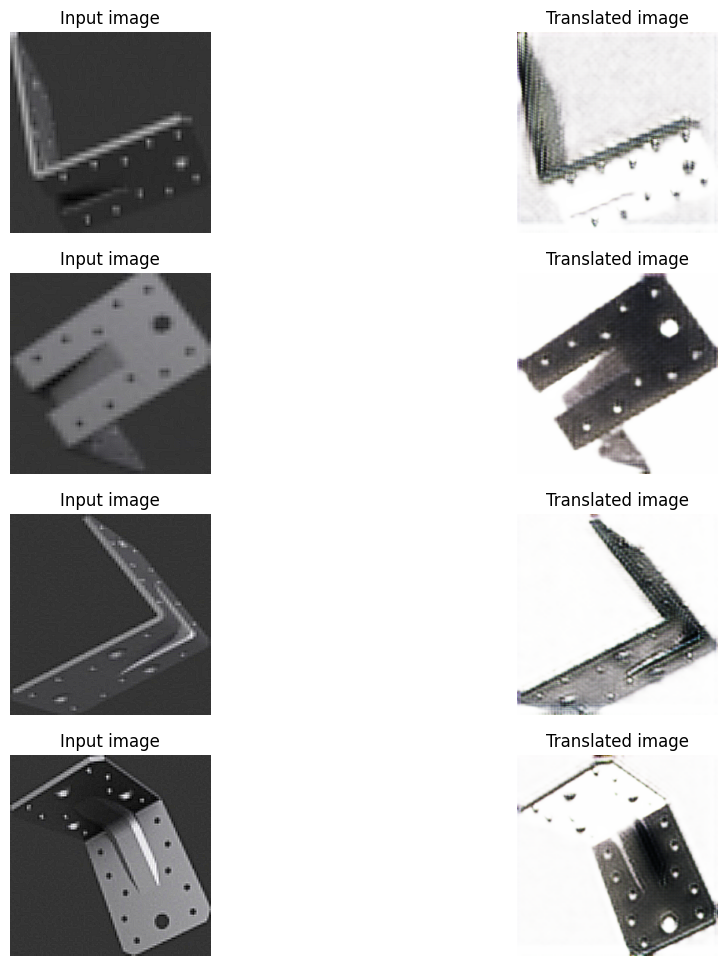

590/590 [==============================] - 133s 226ms/step - G_loss: 2.9354 - F_loss: 2.9943 - D_X_loss: 0.0758 - D_Y_loss: 0.0400
Epoch 20/35
590/590 [==============================] - ETA: 0s - G_loss: 3.0994 - F_loss: 3.0855 - D_X_loss: 0.0722 - D_Y_loss: 0.0274

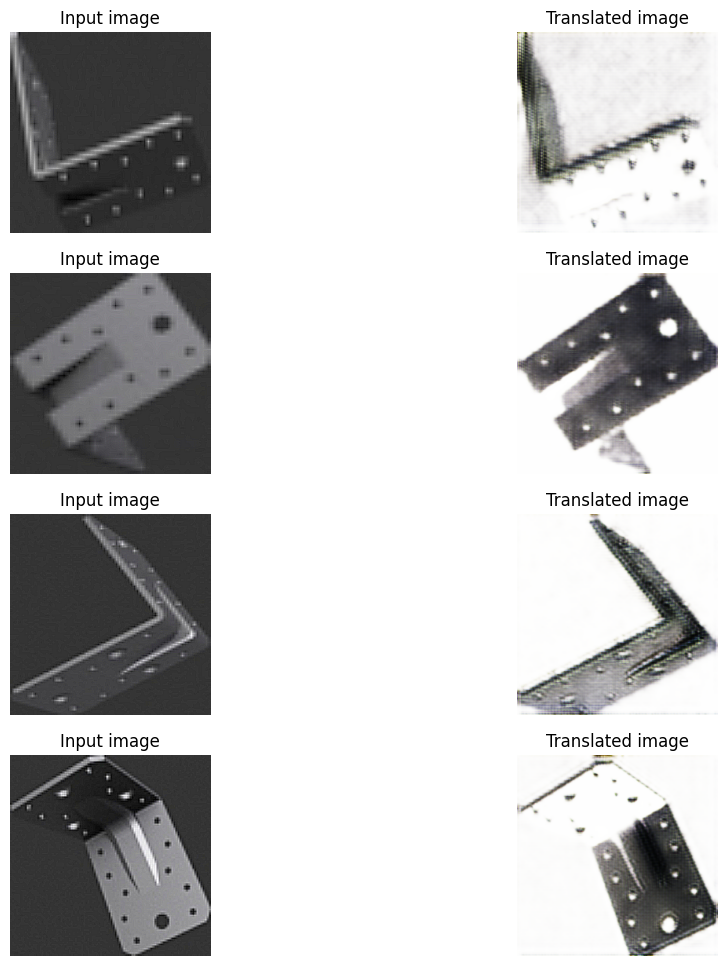

590/590 [==============================] - 133s 225ms/step - G_loss: 3.0976 - F_loss: 3.0877 - D_X_loss: 0.0721 - D_Y_loss: 0.0273
Epoch 21/35
590/590 [==============================] - ETA: 0s - G_loss: 3.0745 - F_loss: 2.9966 - D_X_loss: 0.0756 - D_Y_loss: 0.0310

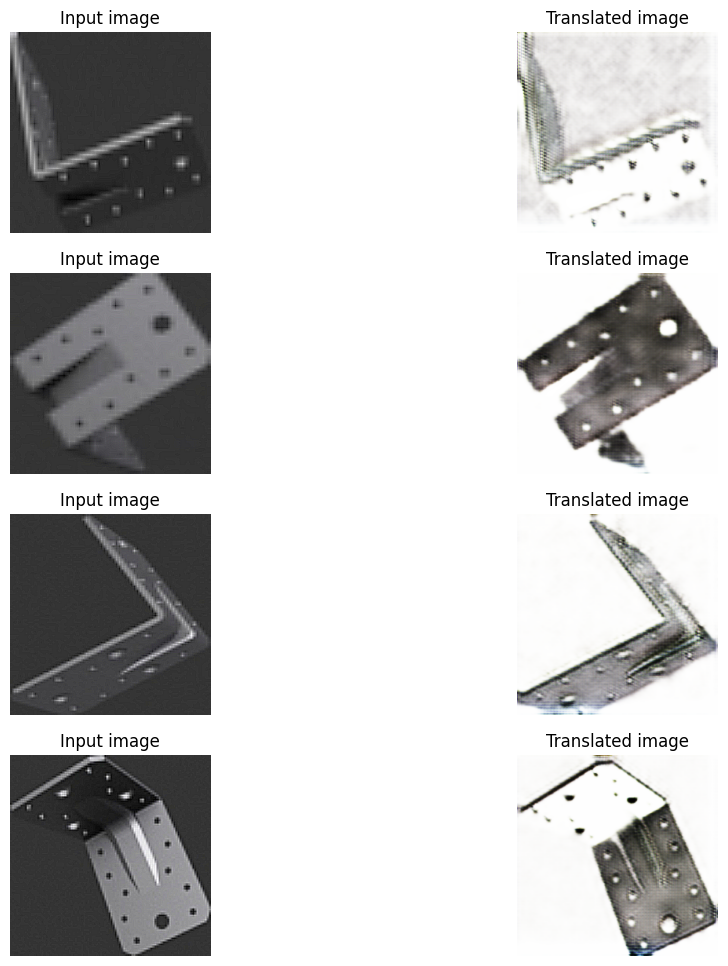

590/590 [==============================] - 133s 226ms/step - G_loss: 3.0722 - F_loss: 2.9981 - D_X_loss: 0.0755 - D_Y_loss: 0.0310
Epoch 22/35
590/590 [==============================] - ETA: 0s - G_loss: 2.8137 - F_loss: 3.0779 - D_X_loss: 0.0657 - D_Y_loss: 0.0298

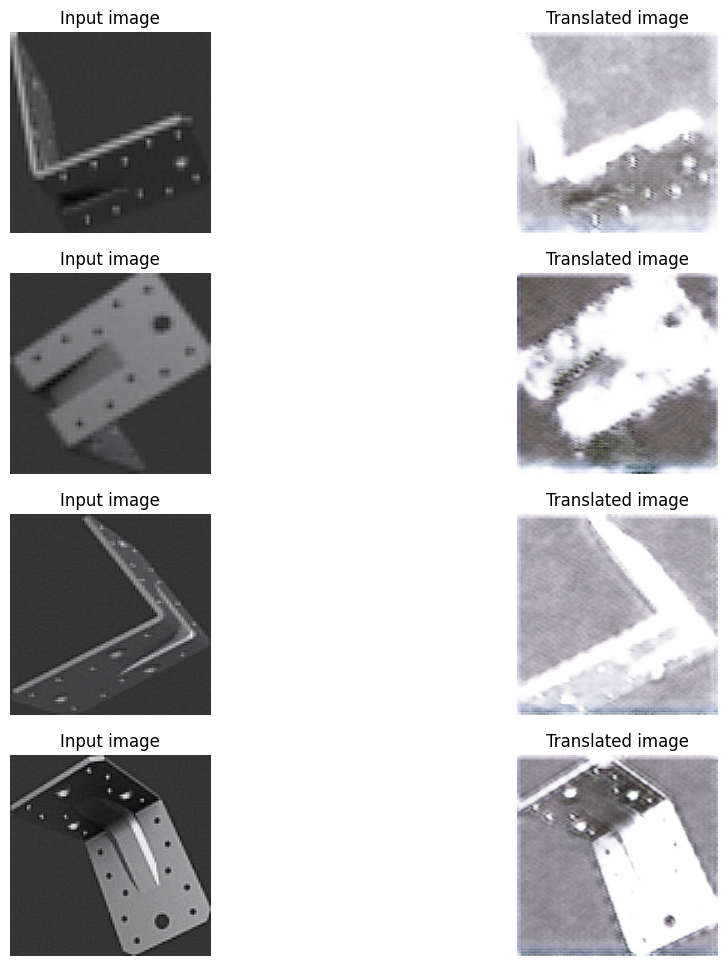

590/590 [==============================] - 133s 226ms/step - G_loss: 2.8144 - F_loss: 3.0805 - D_X_loss: 0.0657 - D_Y_loss: 0.0298
Epoch 23/35
590/590 [==============================] - ETA: 0s - G_loss: 2.9164 - F_loss: 3.0761 - D_X_loss: 0.0547 - D_Y_loss: 0.0308

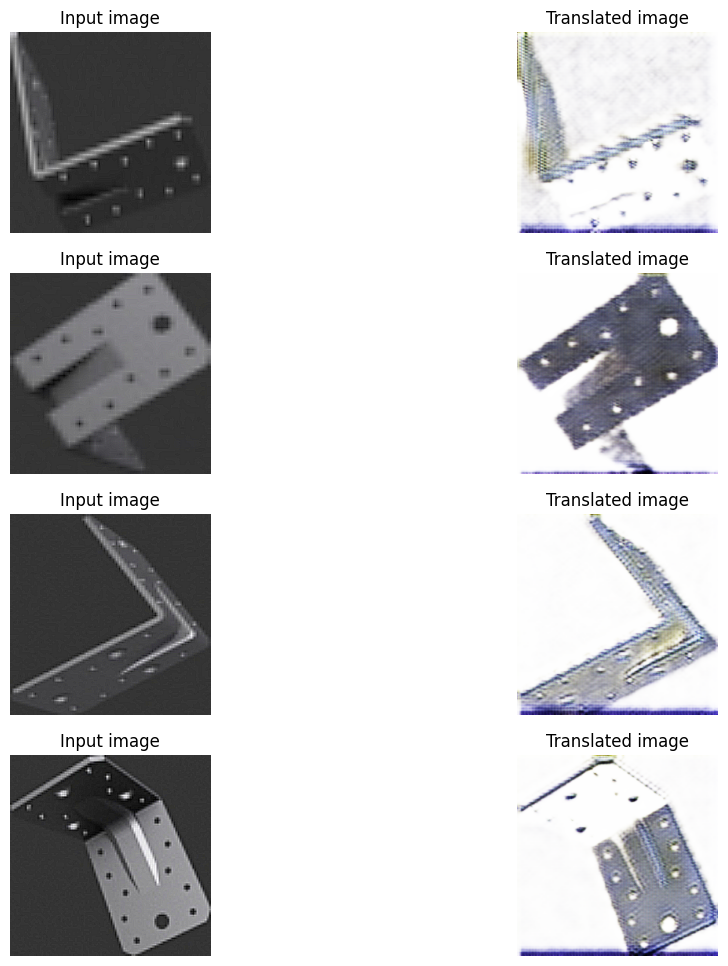

590/590 [==============================] - 135s 228ms/step - G_loss: 2.9159 - F_loss: 3.0778 - D_X_loss: 0.0547 - D_Y_loss: 0.0308
Epoch 24/35
590/590 [==============================] - ETA: 0s - G_loss: 3.1457 - F_loss: 3.0899 - D_X_loss: 0.0544 - D_Y_loss: 0.0174

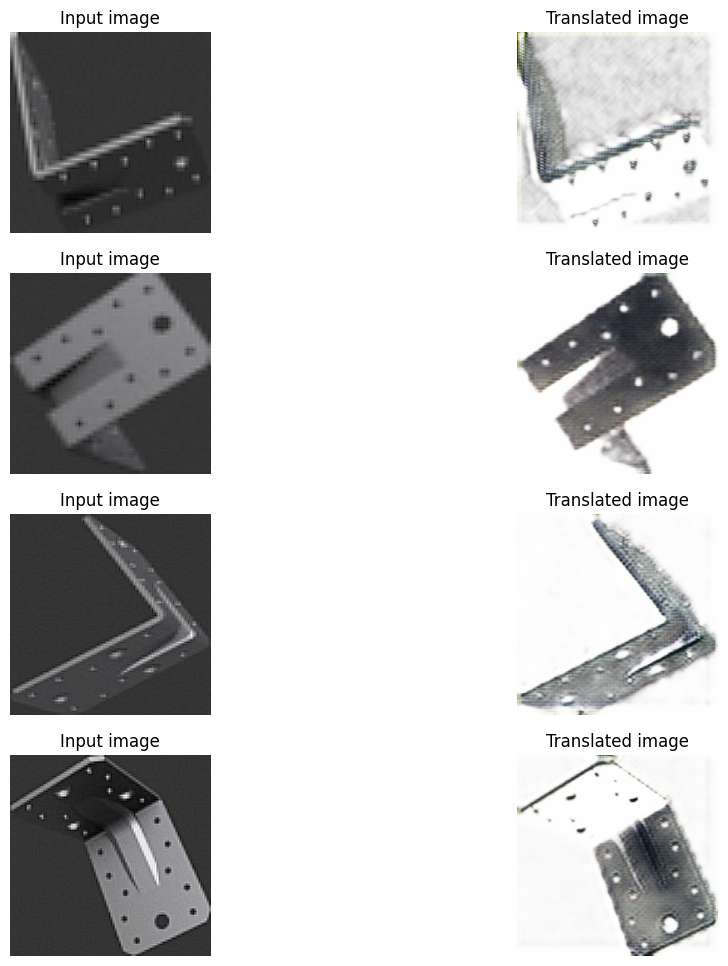

590/590 [==============================] - 132s 224ms/step - G_loss: 3.1438 - F_loss: 3.0917 - D_X_loss: 0.0544 - D_Y_loss: 0.0174
Epoch 25/35
590/590 [==============================] - ETA: 0s - G_loss: 2.8699 - F_loss: 3.0681 - D_X_loss: 0.0548 - D_Y_loss: 0.0295

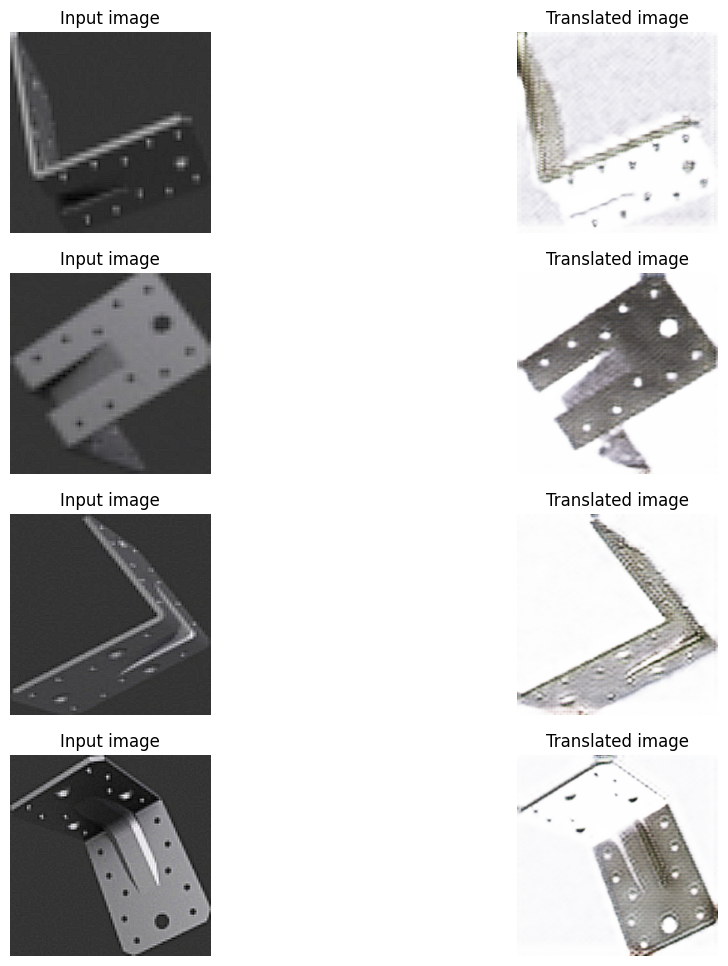

590/590 [==============================] - 133s 225ms/step - G_loss: 2.8686 - F_loss: 3.0696 - D_X_loss: 0.0548 - D_Y_loss: 0.0294
Epoch 26/35
590/590 [==============================] - ETA: 0s - G_loss: 2.7183 - F_loss: 2.9457 - D_X_loss: 0.0546 - D_Y_loss: 0.0247

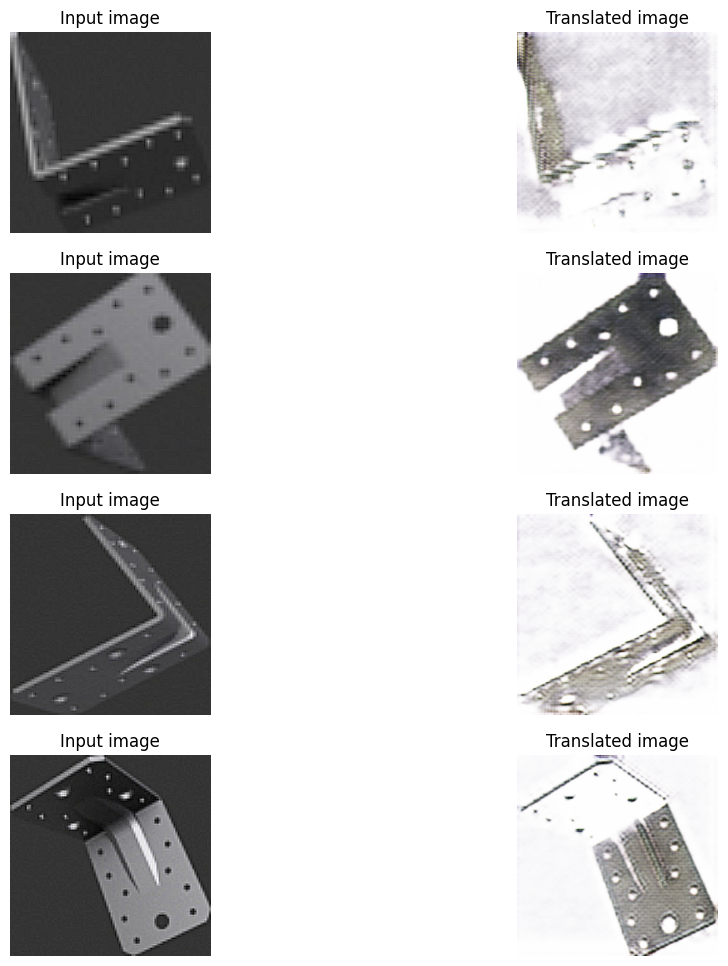

590/590 [==============================] - 132s 224ms/step - G_loss: 2.7169 - F_loss: 2.9476 - D_X_loss: 0.0546 - D_Y_loss: 0.0247
Epoch 27/35
590/590 [==============================] - ETA: 0s - G_loss: 2.6718 - F_loss: 2.9726 - D_X_loss: 0.0534 - D_Y_loss: 0.0310

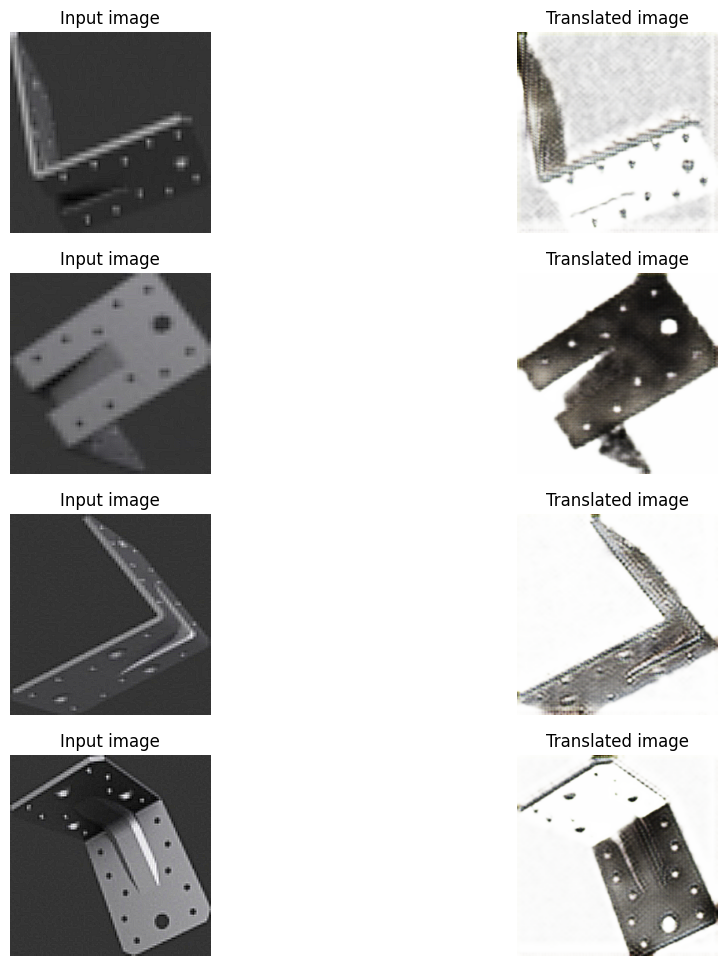

590/590 [==============================] - 132s 224ms/step - G_loss: 2.6697 - F_loss: 2.9750 - D_X_loss: 0.0533 - D_Y_loss: 0.0311
Epoch 28/35
590/590 [==============================] - ETA: 0s - G_loss: 3.1624 - F_loss: 3.0925 - D_X_loss: 0.0489 - D_Y_loss: 0.0141

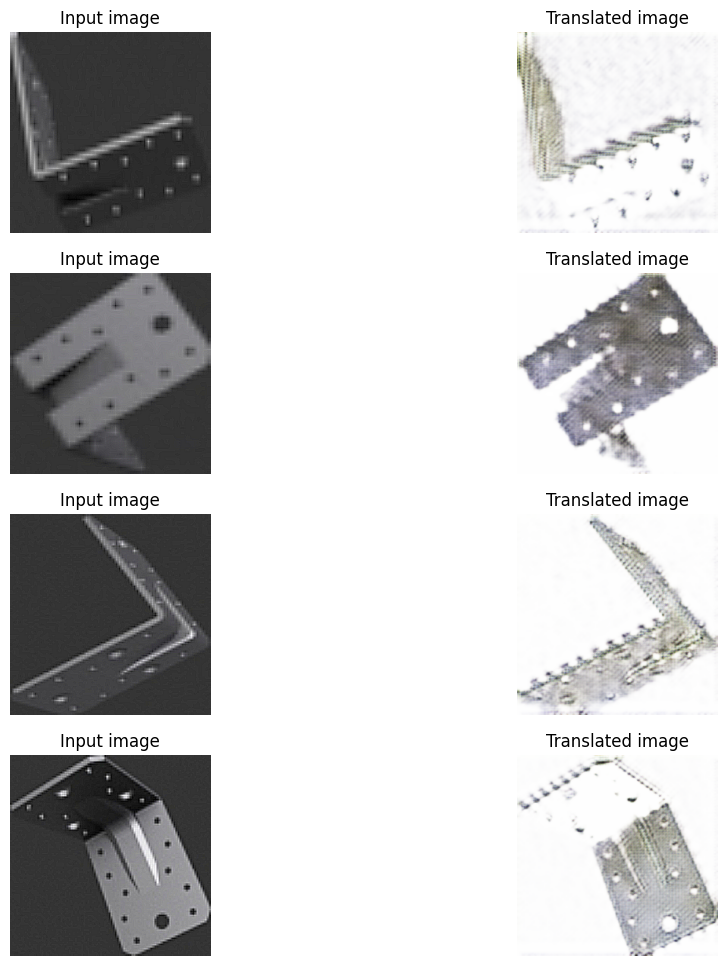

590/590 [==============================] - 137s 232ms/step - G_loss: 3.1600 - F_loss: 3.0939 - D_X_loss: 0.0488 - D_Y_loss: 0.0141
Epoch 29/35
590/590 [==============================] - ETA: 0s - G_loss: 2.7276 - F_loss: 2.9132 - D_X_loss: 0.0496 - D_Y_loss: 0.0284

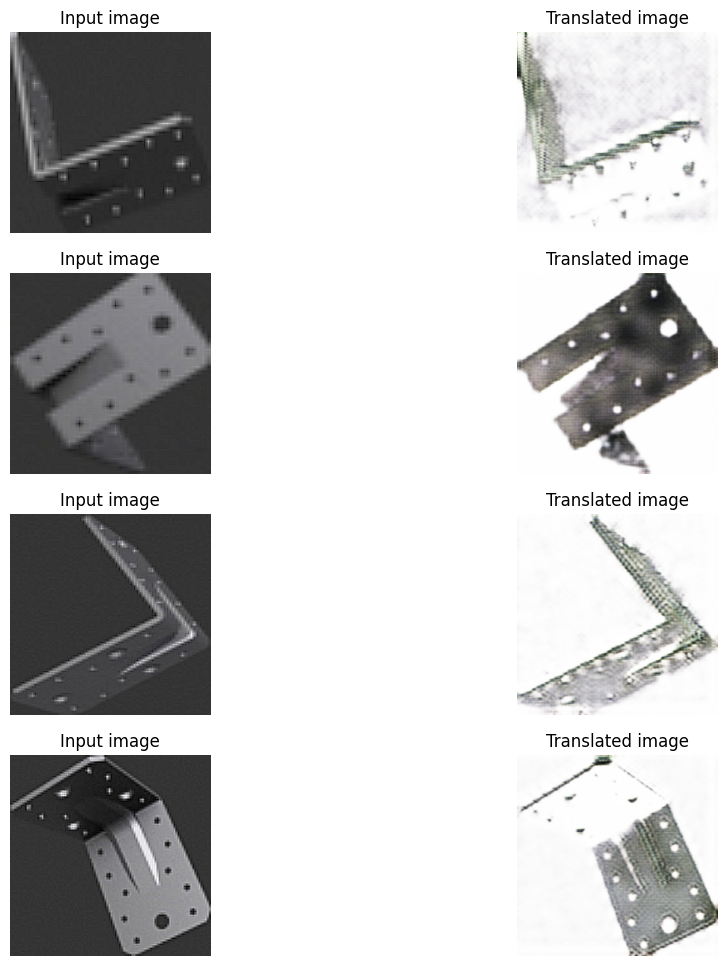

590/590 [==============================] - 135s 228ms/step - G_loss: 2.7252 - F_loss: 2.9151 - D_X_loss: 0.0496 - D_Y_loss: 0.0287
Epoch 30/35
590/590 [==============================] - ETA: 0s - G_loss: 2.7637 - F_loss: 2.9007 - D_X_loss: 0.0480 - D_Y_loss: 0.0258

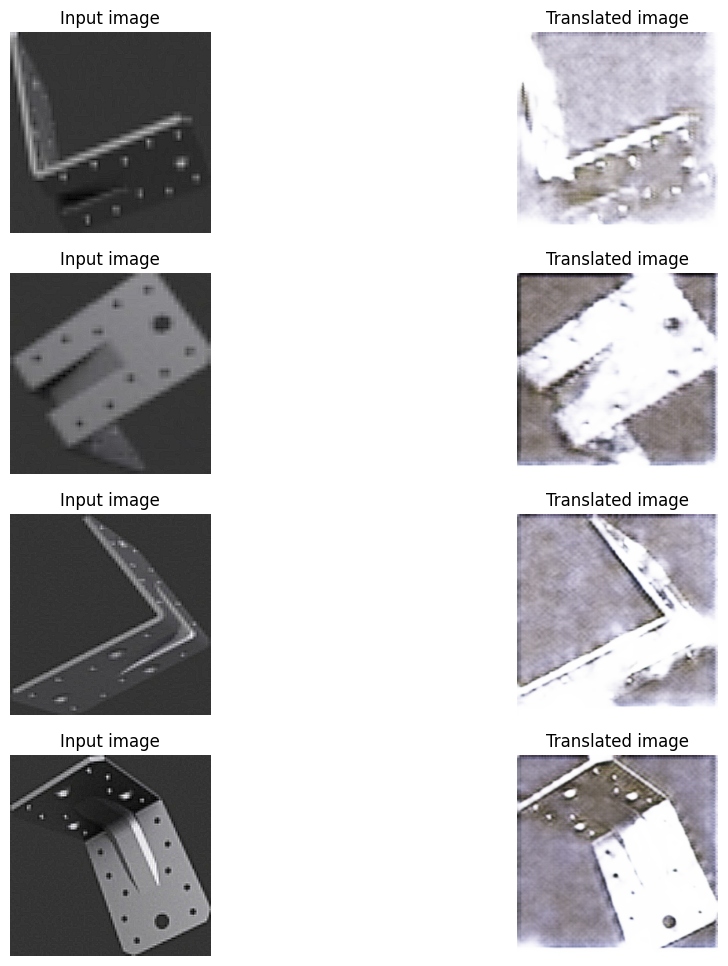

590/590 [==============================] - 134s 228ms/step - G_loss: 2.7633 - F_loss: 2.9033 - D_X_loss: 0.0479 - D_Y_loss: 0.0257
Epoch 31/35
590/590 [==============================] - ETA: 0s - G_loss: 2.7510 - F_loss: 2.9920 - D_X_loss: 0.0423 - D_Y_loss: 0.0189

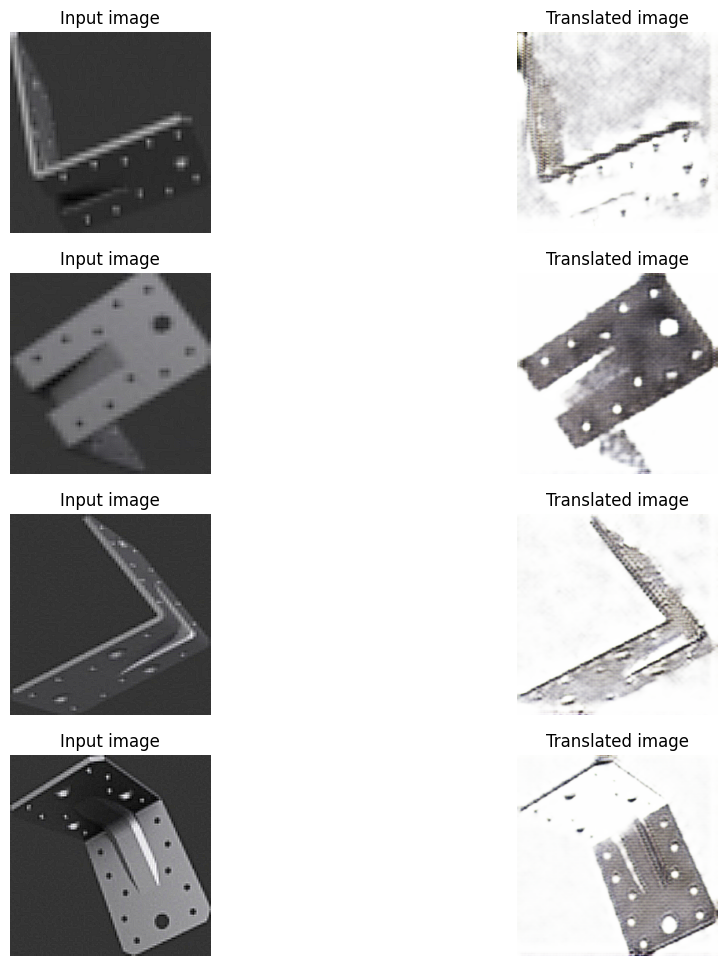

590/590 [==============================] - 134s 227ms/step - G_loss: 2.7504 - F_loss: 2.9940 - D_X_loss: 0.0423 - D_Y_loss: 0.0189
Epoch 32/35
590/590 [==============================] - ETA: 0s - G_loss: 2.6103 - F_loss: 2.8731 - D_X_loss: 0.0423 - D_Y_loss: 0.0257

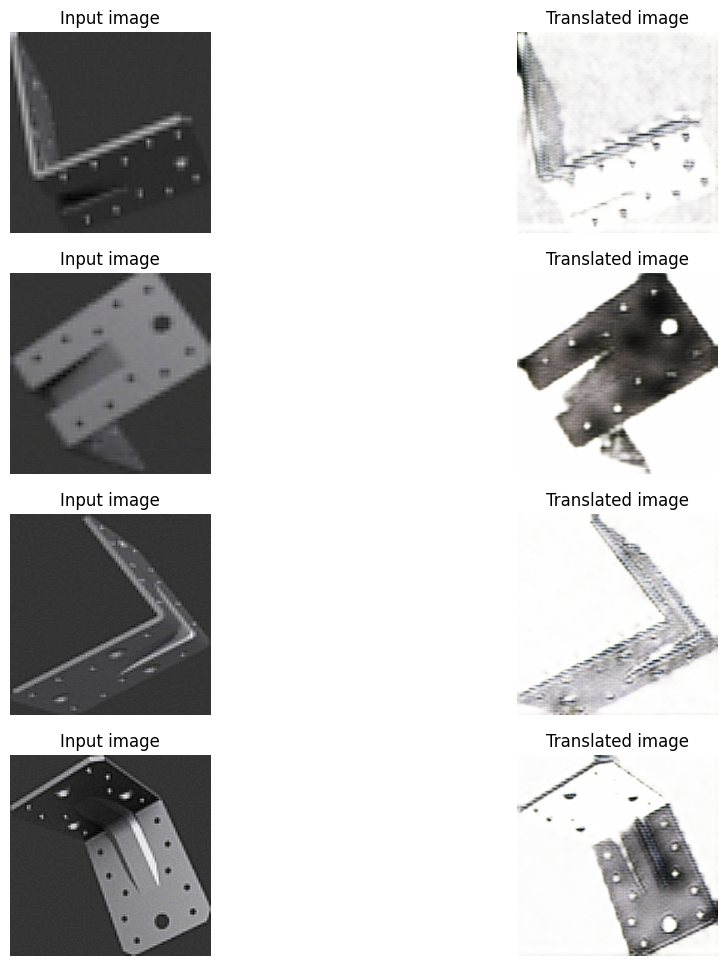

590/590 [==============================] - 144s 244ms/step - G_loss: 2.6087 - F_loss: 2.8749 - D_X_loss: 0.0423 - D_Y_loss: 0.0258
Epoch 33/35
590/590 [==============================] - ETA: 0s - G_loss: 2.5612 - F_loss: 2.8121 - D_X_loss: 0.0454 - D_Y_loss: 0.0295

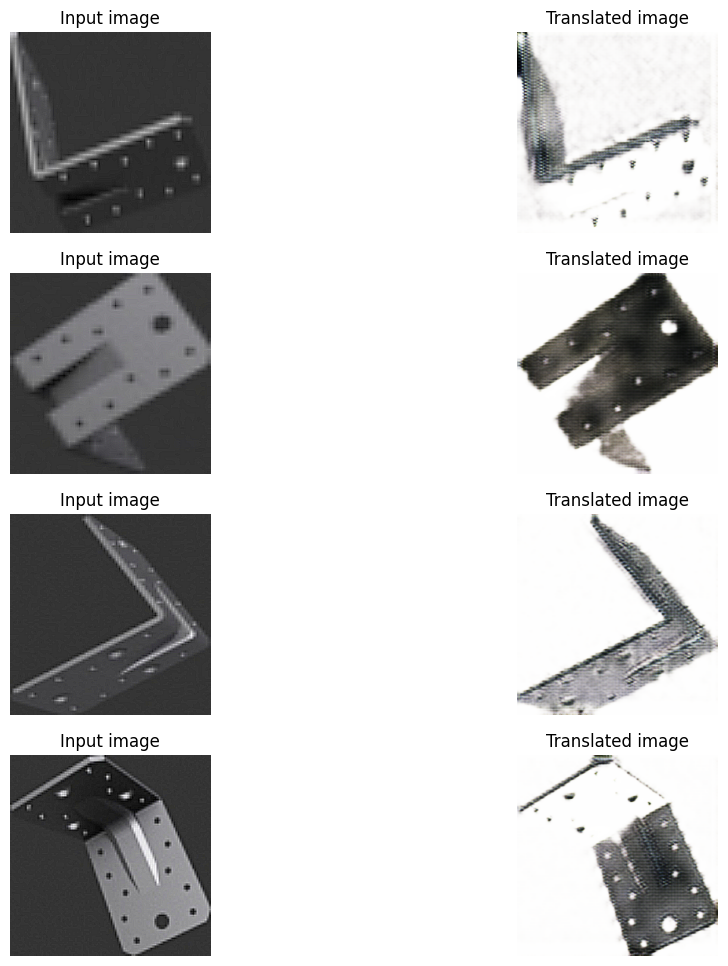

590/590 [==============================] - 161s 273ms/step - G_loss: 2.5596 - F_loss: 2.8129 - D_X_loss: 0.0454 - D_Y_loss: 0.0297
Epoch 34/35
590/590 [==============================] - ETA: 0s - G_loss: 2.7541 - F_loss: 2.9867 - D_X_loss: 0.0426 - D_Y_loss: 0.0092

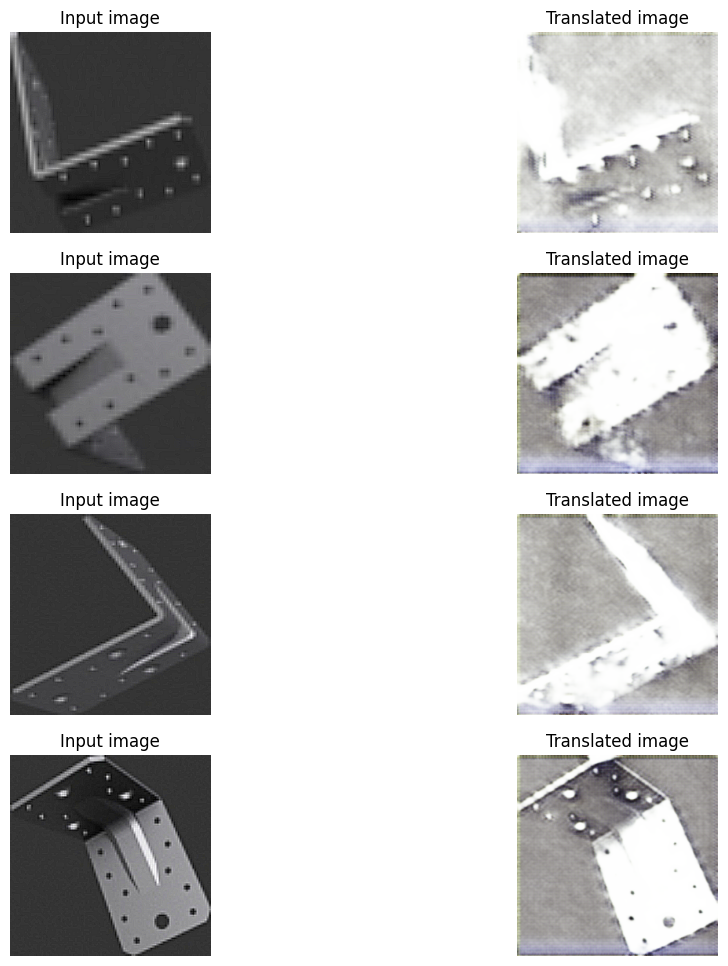

590/590 [==============================] - 163s 276ms/step - G_loss: 2.7533 - F_loss: 2.9882 - D_X_loss: 0.0426 - D_Y_loss: 0.0092
Epoch 35/35
590/590 [==============================] - ETA: 0s - G_loss: 2.8638 - F_loss: 2.9659 - D_X_loss: 0.0369 - D_Y_loss: 0.0047

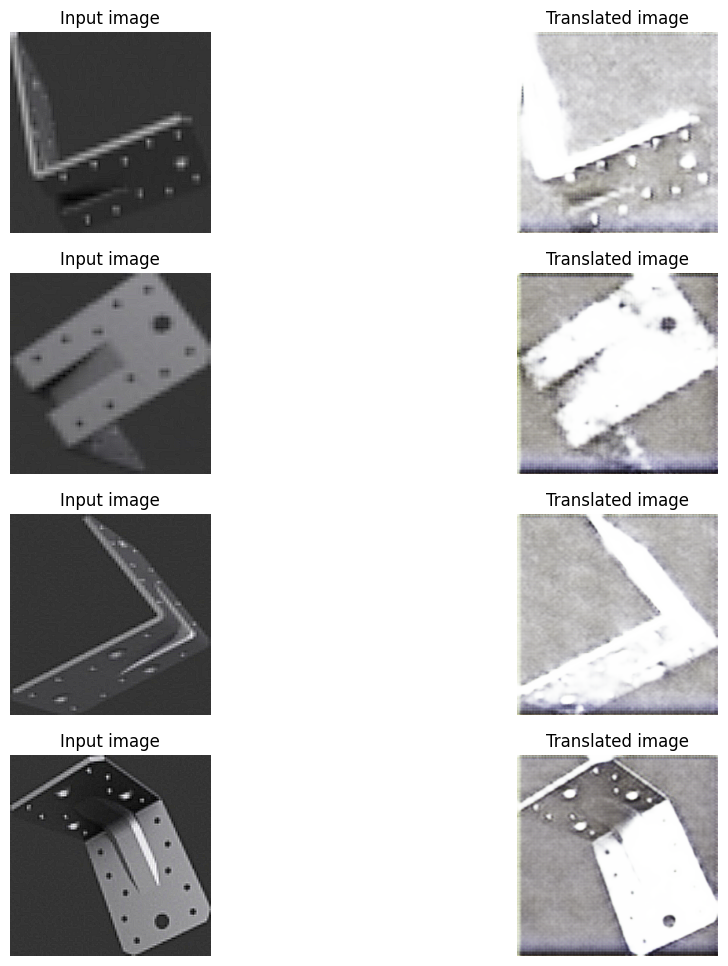

590/590 [==============================] - 163s 276ms/step - G_loss: 2.8625 - F_loss: 2.9677 - D_X_loss: 0.0368 - D_Y_loss: 0.0047


In [24]:
# Loss function for evaluating adversarial loss
adv_loss_fn = keras.losses.MeanSquaredError()

# Define the loss function for the generators
def generator_loss_fn(fake):
    fake_loss = adv_loss_fn(tf.ones_like(fake), fake)
    return fake_loss


# Define the loss function for the discriminators
def discriminator_loss_fn(real, fake):
    real_loss = adv_loss_fn(tf.ones_like(real), real)
    fake_loss = adv_loss_fn(tf.zeros_like(fake), fake)
    return (real_loss + fake_loss) * 0.5


# Create cycle gan model
cycle_gan_model = CycleGan(
    generator_G=gen_G, generator_F=gen_F, discriminator_X=disc_X, discriminator_Y=disc_Y
)

# Compile the model
cycle_gan_model.compile(
    gen_G_optimizer=keras.optimizers.legacy.Adam(learning_rate=2e-4, beta_1=0.5),
    gen_F_optimizer=keras.optimizers.legacy.Adam(learning_rate=2e-4, beta_1=0.5),
    disc_X_optimizer=keras.optimizers.legacy.Adam(learning_rate=2e-4, beta_1=0.5),
    disc_Y_optimizer=keras.optimizers.legacy.Adam(learning_rate=2e-4, beta_1=0.5),
    gen_loss_fn=generator_loss_fn,
    disc_loss_fn=discriminator_loss_fn,
)
# Callbacks
plotter = GANMonitor()
#checkpoint_filepath = "/content/drive/MyDrive/Output/model_checkpoints/cyclegan_checkpoints.{epoch:03d}"
#model_checkpoint_callback = keras.callbacks.ModelCheckpoint(filepath=checkpoint_filepath, save_weights_only=True)

# Here we will train the model for just one epoch as each epoch takes around
# 7 minutes on a single P100 backed machine.
history = cycle_gan_model.fit(
    tf.data.Dataset.zip((t1_dataset, t2_dataset)),
    epochs=35,
    callbacks=[plotter],
    )

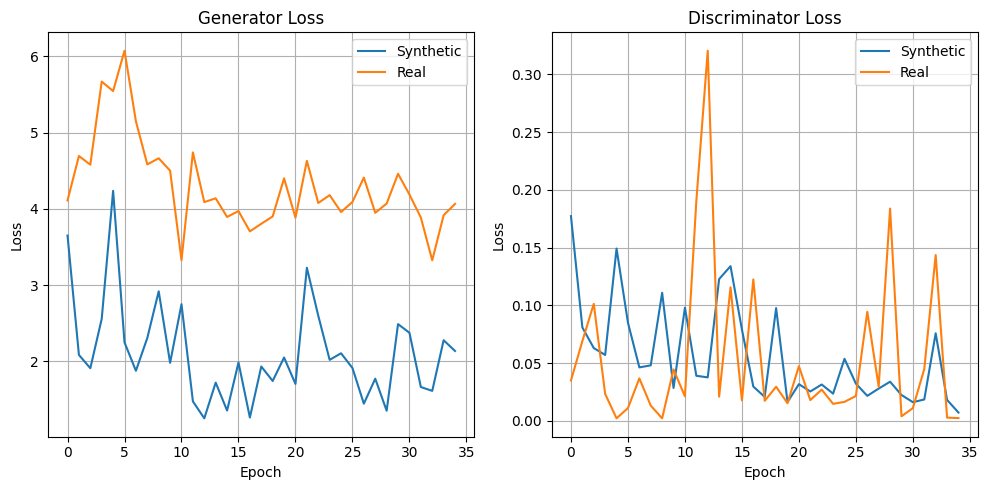

In [25]:
def plot_hist(hist):
    plt.figure(figsize=(10, 5))
    plt.subplot(121)
    plt.plot(hist.history["G_loss"])
    plt.plot(hist.history["F_loss"])
    plt.legend(["Synthetic", "Real"])
    plt.title("Generator Loss")
    plt.ylabel("Loss")
    plt.xlabel("Epoch")
    plt.grid()
    plt.subplot(122)
    plt.plot(hist.history["D_X_loss"])
    plt.plot(hist.history["D_Y_loss"])
    plt.title("Discriminator Loss")
    plt.ylabel("Loss")
    plt.xlabel("Epoch")
    plt.grid()
    plt.legend(["Synthetic", "Real"])
    plt.tight_layout()
    plt.show()


plot_hist(history)

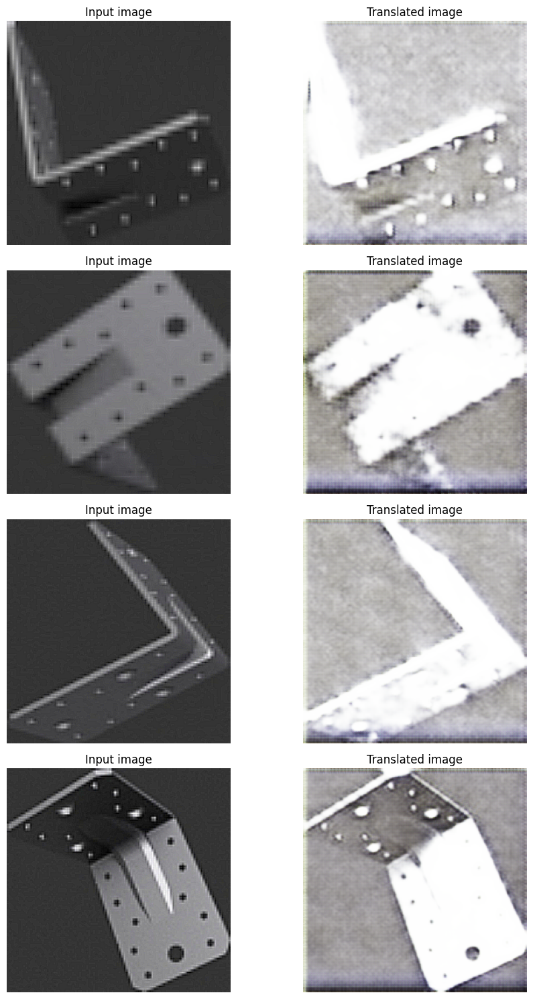

In [26]:
_, ax = plt.subplots(4, 2, figsize=(10, 15))
for i, img in enumerate(t3_dataset.take(4)):
    prediction = cycle_gan_model.gen_G(img, training=False)[0].numpy()
    prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
    img = (img[0] * 127.5 + 127.5).numpy().astype(np.uint8)

    ax[i, 0].imshow(img)
    ax[i, 1].imshow(prediction)
    ax[i, 0].set_title("Input image")
    ax[i, 0].set_title("Input image")
    ax[i, 1].set_title("Translated image")
    ax[i, 0].axis("off")
    ax[i, 1].axis("off")

    prediction = keras.utils.array_to_img(prediction)
    #prediction.save("predicted_img_{i}.png".format(i=i))
plt.tight_layout()
plt.show()